### Import modules

In [1]:
import geopandas as gpd
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
import numpy as np
import os


# Increase the maximum number of columns displayed
pd.set_option('display.max_columns', None)

# If you want to display more rows as well, you can increase the row limit
pd.set_option('display.max_rows', None)


### Functions

### Data import and cleaning

In [2]:
def reverse_columns_by_dates(gdf, dates, building_tree_stats=['mean', 'min', 'max']):
    """
    Reverse the values in the columns associated with specific dates and statistics.
    
    Parameters:
    gdf (GeoDataFrame): The cleaned GeoDataFrame.
    dates (list): A list of dates in 'YYYYMMDD' format.
    building_tree_stats (list): The statistics to reverse for both 'building' and 'tree'.
    """
    columns_to_reverse = []

    # Generate the columns dynamically based on the dates and stats
    for date in dates:
        for stat in building_tree_stats:
            columns_to_reverse.append(f'{date}_building_{stat}')
            columns_to_reverse.append(f'{date}_tree_{stat}')
    
    # Reverse the values in each column
    for column in columns_to_reverse:
        if column in gdf.columns:  # Ensure the column exists in the DataFrame
            gdf[column] = 1 - gdf[column]
    
    return gdf


######### temp adaptation for cycling analysis ######


# Load your data
gdf = gpd.read_file('../results/output/271110/271110_verhardingen_with_stats_multiple_dates.gpkg', engine='pyogrio')

# gdf = gpd.read_file('../results/output/271110/271110_verhardingen_with_stats_20240620.gpkg', engine='pyogrio')
# # List of dates to reverse columns for
# dates_to_reverse = ['20240620']  # Add more dates as needed

##################

# CLEANING
# Check for null values
print(gdf.isnull().sum())
# Display data types of each column
print(gdf.dtypes)

# Clean the DataFrame by removing rows with null values in the relevant column
gdf_cleaned = gdf.dropna(subset=['20240620_building_mean'])  # Change column if necessary
print(f'{len(gdf)} vs {len(gdf_cleaned)}')

# List of dates to reverse columns for
dates_to_reverse = ['20240515', '20240620', '20240715', '20240815', '20240922']  # Add more dates as needed


# Call the function to reverse the columns for the given dates
gdf_cleaned = reverse_columns_by_dates(gdf_cleaned, dates_to_reverse)

# List of columns to include in the boxplot for all specified dates
columns_to_melt = []
for date in dates_to_reverse:
    columns_to_melt.extend([
        f'{date}_building_mean', f'{date}_building_std',
        f'{date}_tree_mean', f'{date}_tree_std',
    ])

# Reshape the GeoDataFrame to long format, selecting only the relevant columns
df = pd.melt(gdf_cleaned[columns_to_melt], var_name='Metric_Category', value_name='Value')

# Split 'Metric_Category' into separate 'Metric' and 'Category' columns
df[['Date', 'Category', 'Metric']] = df['Metric_Category'].str.split('_', expand=True)

# Drop the original 'Metric_Category' column (keep 'Date' this time)
df.drop(columns=['Metric_Category'], inplace=True)

# Dictionary of replacements
replacements = {
    'building': 'Buildings only',
    'tree': 'Buildings and trees',
}

# Replace multiple values
df['Category'] = df['Category'].replace(replacements)

Guid                                            0
Objecttype                                      4
Type                                           97
Type_gedetailleerd                            665
Type_extra_gedetailleerd                     1606
Kleur                                        2165
Type_rijstrook                             180156
Gebruiksfunctie                               459
Wegtype_bestaand                              744
Jaar_uitgevoerd_onderhoud                  101498
Jaar_laatste_conservering                  177784
Jaar_van_aanleg                              2308
Oppervlakte_GIS                                 0
Beheerder_gedetailleerd                         0
Onderhoudsplichtige                        174818
20240515_building_mean                      33186
20240515_building_std                       33186
20240515_building_min                       33186
20240515_building_max                       33186
20240515_building_shade_percent_at_0600     18519


/opt/anaconda3/envs/throwing_shade/lib/python3.12/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [14]:
gdf_cleaned.head()

,Guid,Objecttype,Type,Type_gedetailleerd,Type_extra_gedetailleerd,Kleur,Type_rijstrook,Gebruiksfunctie,Wegtype_bestaand,Jaar_uitgevoerd_onderhoud,Jaar_laatste_conservering,Jaar_van_aanleg,Oppervlakte_GIS,Beheerder_gedetailleerd,Onderhoudsplichtige,20240515_building_mean,20240515_building_std,20240515_building_min,20240515_building_max,20240515_building_shade_percent_at_0600,20240515_building_shade_percent_at_0630,20240515_building_shade_percent_at_0700,20240515_building_shade_percent_at_0730,20240515_building_shade_percent_at_0800,20240515_building_shade_percent_at_0830,20240515_building_shade_percent_at_0900,20240515_building_shade_percent_at_0930,20240515_building_shade_percent_at_1000,20240515_building_shade_percent_at_1030,20240515_building_shade_percent_at_1100,20240515_building_shade_percent_at_1130,20240515_building_shade_percent_at_1200,20240515_building_shade_percent_at_1230,20240515_building_shade_percent_at_1300,20240515_building_shade_percent_at_1330,20240515_building_shade_percent_at_1400,20240515_building_shade_percent_at_1430,20240515_building_shade_percent_at_1500,20240515_building_shade_percent_at_1530,20240515_building_shade_percent_at_1600,20240515_building_shade_percent_at_1630,20240515_building_shade_percent_at_1700,20240515_building_shade_percent_at_1730,20240515_building_shade_percent_at_1800,20240515_building_shade_percent_at_1830,20240515_building_shade_percent_at_1900,20240515_building_shade_percent_at_1930,20240515_building_shade_percent_at_2000,20240515_building_shade_percent_at_2030,20240515_building_shade_percent_at_2100,20240515_tree_mean,20240515_tree_std,20240515_tree_min,20240515_tree_max,20240515_tree_shade_percent_at_0600,20240515_tree_shade_percent_at_0630,20240515_tree_shade_percent_at_0700,20240515_tree_shade_percent_at_0730,20240515_tree_shade_percent_at_0800,20240515_tree_shade_percent_at_0830,20240515_tree_shade_percent_at_0900,20240515_tree_shade_percent_at_0930,20240515_tree_shade_percent_at_1000,20240515_tree_shade_percent_at_1030,20240515_tree_shade_percent_at_1100,20240515_tree_shade_percent_at_1130,20240515_tree_shade_percent_at_1200,20240515_tree_shade_percent_at_1230,20240515_tree_shade_percent_at_1300,20240515_tree_shade_percent_at_1330,20240515_tree_shade_percent_at_1400,20240515_tree_shade_percent_at_1430,20240515_tree_shade_percent_at_1500,20240515_tree_shade_percent_at_1530,20240515_tree_shade_percent_at_1600,20240515_tree_shade_percent_at_1630,20240515_tree_shade_percent_at_1700,20240515_tree_shade_percent_at_1730,20240515_tree_shade_percent_at_1800,20240515_tree_shade_percent_at_1830,20240515_tree_shade_percent_at_1900,20240515_tree_shade_percent_at_1930,20240515_tree_shade_percent_at_2000,20240515_tree_shade_percent_at_2030,20240515_tree_shade_percent_at_2100,20240620_building_mean,20240620_building_std,20240620_building_min,20240620_building_max,20240620_building_shade_percent_at_0530,20240620_building_shade_percent_at_0600,20240620_building_shade_percent_at_0630,20240620_building_shade_percent_at_0700,20240620_building_shade_percent_at_0730,20240620_building_shade_percent_at_0800,20240620_building_shade_percent_at_0830,20240620_building_shade_percent_at_0900,20240620_building_shade_percent_at_0930,20240620_building_shade_percent_at_1000,20240620_building_shade_percent_at_1030,20240620_building_shade_percent_at_1100,20240620_building_shade_percent_at_1130,20240620_building_shade_percent_at_1200,20240620_building_shade_percent_at_1230,20240620_building_shade_percent_at_1300,20240620_building_shade_percent_at_1330,20240620_building_shade_percent_at_1400,20240620_building_shade_percent_at_1430,20240620_building_shade_percent_at_1500,20240620_building_shade_percent_at_1530,20240620_building_shade_percent_at_1600,20240620_building_shade_percent_at_1630,20240620_building_shade_percent_at_1700,20240620_building_shade_percent_at_1730,20240620_building_shade_percent_at_1800,20240620_building_shade_percent_at_1830,20240620_building_shade_percent_at_1900,20240620_building_shade_p

In [3]:
def plot_shade_metrics(df, background='dark', save_path=None, file_name=None):
    """
    Plots boxplots of shade metrics for buildings and trees across different dates, focusing on the 'mean' metric.
    Optionally saves the plot to a specified folder with a chosen name.
    
    Parameters:
    df (DataFrame): The reshaped DataFrame containing 'Metric', 'Value', 'Category', and 'Date'.
    background (str): Either 'dark' or 'light' to set the plot background.
    save_path (str): Path to the folder where the plot should be saved. If None, the plot is not saved.
    file_name (str): Name for the saved plot file. If None, the plot is not saved.
    """
    # Filter the DataFrame to only include 'mean' metrics
    df_mean = df[df['Metric'] == 'mean']

    # Set the plot style based on the background parameter
    if background == 'dark':
        sns.set_style("darkgrid")
        text_color = 'white'
        palette = {'Buildings only': '#7f8c8d', 'Buildings and trees': '#2ecc71'}  # Grey and Green
        fig_color = '#2e2e2e'  # Dark background for figure
    else:
        sns.set_style("whitegrid")
        text_color = 'black'
        palette = {'Buildings only': '#34495e', 'Buildings and trees': '#27ae60'}  # Darker grey and Green
        fig_color = 'white'  # Light background for figure

    # Create the figure and axes
    fig, ax = plt.subplots(figsize=(10, 8))

    # Set figure background color
    fig.patch.set_facecolor(fig_color)
    ax.set_facecolor(fig_color if background == 'light' else '#1a1a1a')  # Darker plot area for dark background

    # Create the boxplot with the custom palette
    # sns.boxplot(x='Date', y='Value', hue='Category', data=df_mean, palette=palette, ax=ax)

    sns.violinplot(x='Date', y='Value', hue='Category', data=df_mean, palette=palette, ax=ax, split=True, gap=.1, inner="quart")

    # Annotate each boxplot with mean and median values
    for i, (date, category) in enumerate([(d, c) for d in df_mean['Date'].unique() for c in df_mean['Category'].unique()]):
        subset = df_mean[(df_mean['Date'] == date) & (df_mean['Category'] == category)]['Value']
        if subset.empty:
            continue

        # Calculate statistics
        median_value = np.median(subset)
        mean_value = np.mean(subset)

        # Get x position of the current boxplot
        x_position = i // len(df_mean['Category'].unique()) + (i % len(df_mean['Category'].unique())) * 0.4 - 0.18

        # Annotate with the calculated values
        ax.text(x_position, median_value, f'Median: {median_value*100:.0f}%', ha='center', va='bottom', color=text_color, fontsize=10, weight='bold')
        ax.text(x_position, mean_value, f'Mean: {mean_value*100:.0f}%', ha='center', va='top', color='yellow' if background == 'dark' else 'black', fontsize=10)
    
    # Customize the plot
    ax.set_title('Daily Shade Percentage on All Surfaces', color=text_color, fontsize=18)
    ax.set_xlabel('Date', color=text_color)
    ax.set_ylabel('Sun Exposure', color=text_color)

    # Convert y-axis to percentage
    ax.yaxis.set_major_formatter(mticker.FuncFormatter(lambda y, _: f'{y*100:.0f}%'))

    # Customize the axes
    ax.spines['top'].set_color(text_color)
    ax.spines['right'].set_color(text_color)
    ax.spines['left'].set_color(text_color)
    ax.spines['bottom'].set_color(text_color)
    ax.tick_params(axis='x', colors=text_color)
    ax.tick_params(axis='y', colors=text_color)

    # Adjust the legend
    legend = ax.legend(title='Category', frameon=False, loc='upper right')
    plt.setp(legend.get_title(), color=text_color)
    for text in legend.get_texts():
        text.set_color(text_color)

    # Save the plot if the path and file name are provided
    if save_path and file_name:
        # Ensure the save directory exists
        os.makedirs(save_path, exist_ok=True)
        full_path = os.path.join(save_path, f"{file_name}.png")
        plt.savefig(full_path, bbox_inches='tight', facecolor=fig.get_facecolor())
        print(f"Plot saved at {full_path}")
    
    # Show the plot
    plt.show()

Plot saved at ../results/figures/240917_daily_multiple_days_dark.png


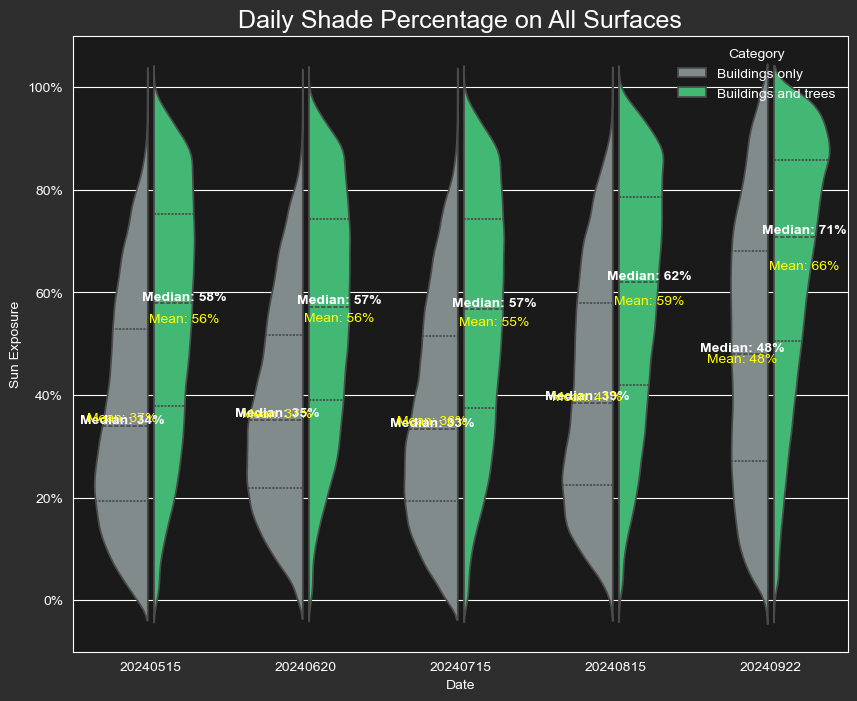

In [4]:
# Example usage:
plot_shade_metrics(df, background='dark', save_path='../results/figures/', file_name='240917_daily_multiple_days_dark')

Plot saved at ../results/figures/240917_daily_multiple_days_light.png


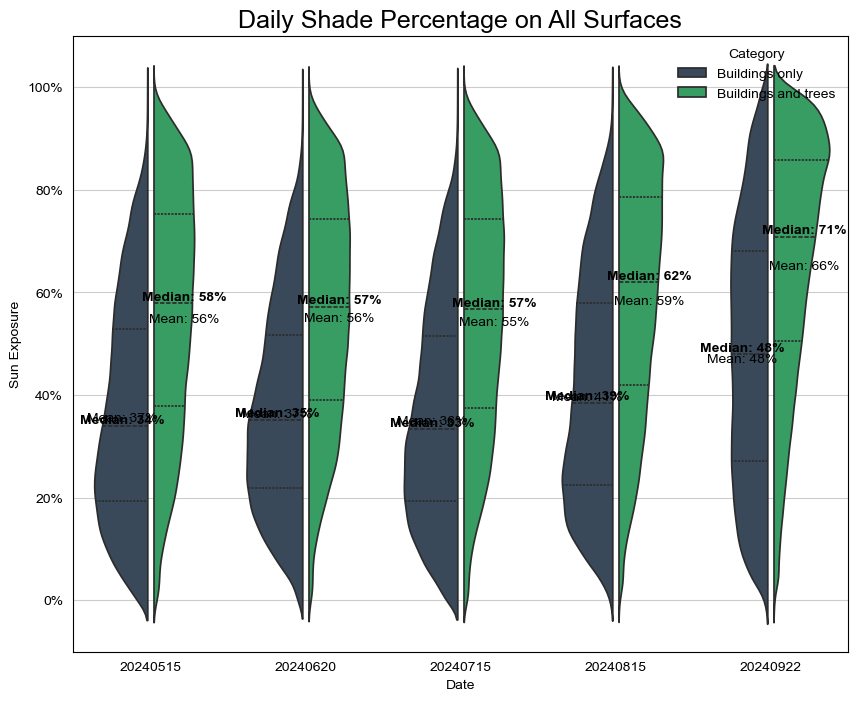

In [5]:
# Example usage:
plot_shade_metrics(df, background='light', save_path='../results/figures/', file_name='240917_daily_multiple_days_light')

### Significance testing:

In [11]:
from scipy.stats import ttest_rel, wilcoxon
# Paired t-test for each pair of columns
ttest_results = {}
wilcoxon_results = {}


pairs = [
    ('20240620_building_mean', '20240620_tree_mean'),
    ('20240620_building_std', '20240620_tree_std'),
    ('20240620_building_min', '20240620_tree_min'),
    ('20240620_building_max', '20240620_tree_max')
]

for col1, col2 in pairs:
    # Paired t-test
    ttest_result = ttest_rel(gdf_cleaned[col1], gdf_cleaned[col2])
    ttest_results[f'{col1} vs {col2}'] = ttest_result
    
    # Wilcoxon signed-rank test (non-parametric alternative)
    wilcoxon_result = wilcoxon(gdf_cleaned[col1], gdf_cleaned[col2])
    wilcoxon_results[f'{col1} vs {col2}'] = wilcoxon_result

# Results
print("Paired t-test results:")
print(ttest_results)

print("\nWilcoxon signed-rank test results:")
print(wilcoxon_results)

Paired t-test results:
{'20240620_building_mean vs 20240620_tree_mean': TtestResult(statistic=-423.1116267168231, pvalue=0.0, df=147985), '20240620_building_std vs 20240620_tree_std': TtestResult(statistic=-204.25073358510957, pvalue=0.0, df=147985), '20240620_building_min vs 20240620_tree_min': TtestResult(statistic=-414.4220855368247, pvalue=0.0, df=147985), '20240620_building_max vs 20240620_tree_max': TtestResult(statistic=-335.53960842910067, pvalue=0.0, df=147985)}

Wilcoxon signed-rank test results:
{'20240620_building_mean vs 20240620_tree_mean': WilcoxonResult(statistic=123400.0, pvalue=0.0), '20240620_building_std vs 20240620_tree_std': WilcoxonResult(statistic=2248018862.0, pvalue=0.0), '20240620_building_min vs 20240620_tree_min': WilcoxonResult(statistic=68858.5, pvalue=0.0), '20240620_building_max vs 20240620_tree_max': WilcoxonResult(statistic=654320.0, pvalue=0.0)}


In [12]:
ttest_results

{'20240620_building_mean vs 20240620_tree_mean': TtestResult(statistic=-423.1116267168231, pvalue=0.0, df=147985),
 '20240620_building_std vs 20240620_tree_std': TtestResult(statistic=-204.25073358510957, pvalue=0.0, df=147985),
 '20240620_building_min vs 20240620_tree_min': TtestResult(statistic=-414.4220855368247, pvalue=0.0, df=147985),
 '20240620_building_max vs 20240620_tree_max': TtestResult(statistic=-335.53960842910067, pvalue=0.0, df=147985)}

__Remove Values__

In [101]:
values_to_remove = ['Berm', 'Verkeersgeleiding','Verkeerseiland','Parkeervak','Erf','Parkeerstrook','Parkeerterrein','None','Woonerf','Bodem','Woonfunctie','Anti-parkeer','Boomspiegel','Functioneel','Opslag', 'Busperron','Hellingbaan','Rotonde','Doorsteek','Rijstrookscheiding ','Loswal','Parkeervak fietsen','Overweg','Dienst (bij gebouwen)','Containeropstelplaats','Haagvak','Fietsenstandplaats']
filtered_gdf = gdf_cleaned[~gdf_cleaned['Gebruiksfunctie'].isin(values_to_remove)]

In [10]:
gdf_cleaned.Gebruiksfunctie.unique()

array(['Berm', 'Halte eiland', 'Voetpad', 'Verkeersgeleiding',
       'Verkeerseiland', 'Parkeervak', 'Fietspad', 'Rijbaan',
       'Haltekom OV', 'Containeropstelplaats', 'Halte voetpad',
       'Voetpad op trap', 'Fietsenstandplaats', 'Inrit', 'Trambaan',
       'Voetgangersgebied', 'Erf', 'Haltekom', 'Busbaan', 'OV-baan',
       'Parkeerstrook', 'Parkeerterrein', 'Speelondergrond', 'Haagvak',
       'Spoorbaan', 'Ruiterpad', None, 'Sportondergrond', 'Winkelerf',
       'Loswal', 'Woonerf', 'Recreatie', 'Functioneel', 'Plein', 'Bodem',
       'Dienst (bij gebouwen)', 'Doorsteek', 'Woonfunctie',
       'Anti-parkeer', 'Opslag', 'Boomspiegel', 'Rijstrookscheiding ',
       'Verkeersdrempel', 'Overweg', 'Hellingbaan', 'Rotonde',
       'Parkeervak fietsen'], dtype=object)

In [3]:
values_to_keep = ['Voetpad','Voetpad op trap', 'Voetgangersgebied', 'Fietspad', 'Rijbaan']
filtered_gdf = gdf_cleaned[gdf_cleaned['Gebruiksfunctie'].isin(values_to_keep)]

# Dictionary of replacements
replacements = {
    'Voetpad': 'Sidewalk',
    'Voetpad op trap': 'Sidewalk',
    'Voetgangersgebied': 'Sidewalk',
    'Fietspad':'Cycle lane',
    'Rijbaan':'Road',
}

# Replace multiple values
filtered_gdf['Gebruiksfunctie'] = filtered_gdf['Gebruiksfunctie'].replace(replacements)

filtered_gdf.Gebruiksfunctie.unique()

/opt/anaconda3/envs/throwing_shade/lib/python3.12/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


array(['Sidewalk', 'Cycle lane', 'Road'], dtype=object)

### Add administrative boundaries:

In [4]:
buurten = gpd.read_file('../data/raw_data/ams/geojson_lnglat.json')

filtered_gdf = filtered_gdf.to_crs(buurten.crs)

filtered_gdf = gpd.sjoin(filtered_gdf, buurten[['geometry','CBS_Buurtcode', 'Buurtcode', 
                                                       'Buurt', 'Wijkcode', 'Wijk', 'Gebiedcode', 
                                                       'Gebied', 'Stadsdeelcode', 'Stadsdeel']], how='left', op='intersects')

filtered_gdf.reset_index(inplace=True)

filtered_gdf.head()

/opt/anaconda3/envs/throwing_shade/lib/python3.12/site-packages/IPython/core/interactiveshell.py:3517: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


,index,Guid,Objecttype,Type,Type_gedetailleerd,Type_extra_gedetailleerd,Kleur,Type_rijstrook,Gebruiksfunctie,Wegtype_bestaand,Jaar_uitgevoerd_onderhoud,Jaar_laatste_conservering,Jaar_van_aanleg,Oppervlakte_GIS,Beheerder_gedetailleerd,Onderhoudsplichtige,20240515_building_mean,20240515_building_std,20240515_building_min,20240515_building_max,20240515_building_shade_percent_at_0600,20240515_building_shade_percent_at_0630,20240515_building_shade_percent_at_0700,20240515_building_shade_percent_at_0730,20240515_building_shade_percent_at_0800,20240515_building_shade_percent_at_0830,20240515_building_shade_percent_at_0900,20240515_building_shade_percent_at_0930,20240515_building_shade_percent_at_1000,20240515_building_shade_percent_at_1030,20240515_building_shade_percent_at_1100,20240515_building_shade_percent_at_1130,20240515_building_shade_percent_at_1200,20240515_building_shade_percent_at_1230,20240515_building_shade_percent_at_1300,20240515_building_shade_percent_at_1330,20240515_building_shade_percent_at_1400,20240515_building_shade_percent_at_1430,20240515_building_shade_percent_at_1500,20240515_building_shade_percent_at_1530,20240515_building_shade_percent_at_1600,20240515_building_shade_percent_at_1630,20240515_building_shade_percent_at_1700,20240515_building_shade_percent_at_1730,20240515_building_shade_percent_at_1800,20240515_building_shade_percent_at_1830,20240515_building_shade_percent_at_1900,20240515_building_shade_percent_at_1930,20240515_building_shade_percent_at_2000,20240515_building_shade_percent_at_2030,20240515_building_shade_percent_at_2100,20240515_tree_mean,20240515_tree_std,20240515_tree_min,20240515_tree_max,20240515_tree_shade_percent_at_0600,20240515_tree_shade_percent_at_0630,20240515_tree_shade_percent_at_0700,20240515_tree_shade_percent_at_0730,20240515_tree_shade_percent_at_0800,20240515_tree_shade_percent_at_0830,20240515_tree_shade_percent_at_0900,20240515_tree_shade_percent_at_0930,20240515_tree_shade_percent_at_1000,20240515_tree_shade_percent_at_1030,20240515_tree_shade_percent_at_1100,20240515_tree_shade_percent_at_1130,20240515_tree_shade_percent_at_1200,20240515_tree_shade_percent_at_1230,20240515_tree_shade_percent_at_1300,20240515_tree_shade_percent_at_1330,20240515_tree_shade_percent_at_1400,20240515_tree_shade_percent_at_1430,20240515_tree_shade_percent_at_1500,20240515_tree_shade_percent_at_1530,20240515_tree_shade_percent_at_1600,20240515_tree_shade_percent_at_1630,20240515_tree_shade_percent_at_1700,20240515_tree_shade_percent_at_1730,20240515_tree_shade_percent_at_1800,20240515_tree_shade_percent_at_1830,20240515_tree_shade_percent_at_1900,20240515_tree_shade_percent_at_1930,20240515_tree_shade_percent_at_2000,20240515_tree_shade_percent_at_2030,20240515_tree_shade_percent_at_2100,20240620_building_mean,20240620_building_std,20240620_building_min,20240620_building_max,20240620_building_shade_percent_at_0530,20240620_building_shade_percent_at_0600,20240620_building_shade_percent_at_0630,20240620_building_shade_percent_at_0700,20240620_building_shade_percent_at_0730,20240620_building_shade_percent_at_0800,20240620_building_shade_percent_at_0830,20240620_building_shade_percent_at_0900,20240620_building_shade_percent_at_0930,20240620_building_shade_percent_at_1000,20240620_building_shade_percent_at_1030,20240620_building_shade_percent_at_1100,20240620_building_shade_percent_at_1130,20240620_building_shade_percent_at_1200,20240620_building_shade_percent_at_1230,20240620_building_shade_percent_at_1300,20240620_building_shade_percent_at_1330,20240620_building_shade_percent_at_1400,20240620_building_shade_percent_at_1430,20240620_building_shade_percent_at_1500,20240620_building_shade_percent_at_1530,20240620_building_shade_percent_at_1600,20240620_building_shade_percent_at_1630,20240620_building_shade_percent_at_1700,20240620_building_shade_percent_at_1730,20240620_building_shade_percent_at_1800,20240620_building_shade_percent_at_1830,20240620_building_shade_percent_at_1900,20240620_building_s

In [58]:
time_increments = ['1130', '1200', '1230', '1300', '1330', '1400', '1430', '1500', '1530', '1600', '1630', '1700']

columns_to_average = []
for time in time_increments:
    column_name = f'20240620_tree_shade_percent_at_{time}'
    columns_to_average.append(column_name)
    # print(columns_to_average)

# Calculate the average across specific columns
filtered_gdf['202406_tree_shade_percent_day_average'] = filtered_gdf[columns_to_average].mean(axis=1)

In [59]:
cycling = filtered_gdf.loc[filtered_gdf['Gebruiksfunctie']=='Cycle lane']
sidewalks = filtered_gdf.loc[filtered_gdf['Gebruiksfunctie']=='Sidewalk']
driving = filtered_gdf.loc[filtered_gdf['Gebruiksfunctie']=='Road']

### Sidewalks below 30% 

[]

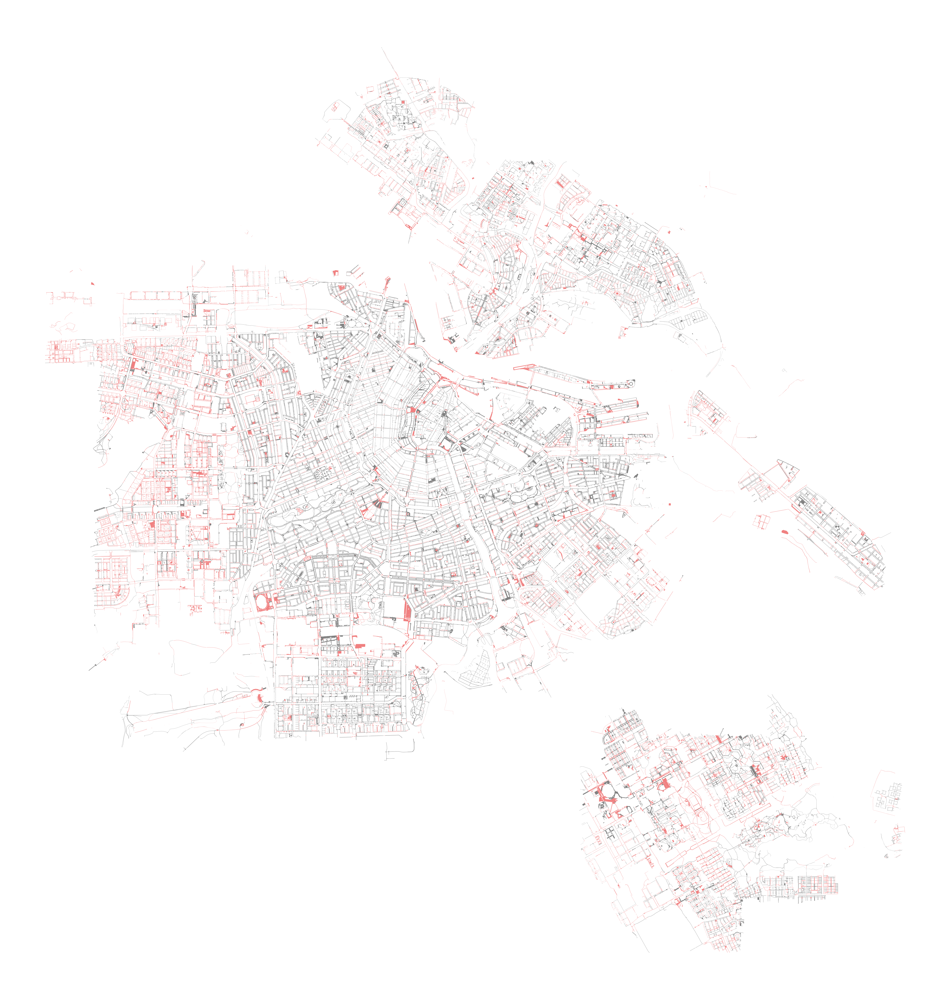

In [60]:

# time_increments = ['1130', '1200', '1230', '1300', '1330', '1400', '1430', '1500', '1530', '1600', '1630', '1700']

# columns_to_average = []
# for time in time_increments:
#     column_name = f'20240620_tree_shade_percent_at_{time}'
#     columns_to_average.append(column_name)
#     # print(columns_to_average)

# # Calculate the average across specific columns
# sidewalks['202406_tree_shade_percent_day_average'] = sidewalks[columns_to_average].mean(axis=1)

# Filter for streets with insufficient shade coverage
threshold = 30
low_shade_streets = sidewalks[sidewalks['202406_tree_shade_percent_day_average'] < threshold]
high_shade_streets = sidewalks[sidewalks['202406_tree_shade_percent_day_average'] > threshold]

# Plot
# fig, ax = plt.subplots(figsize=(8.27, 11.69))  # A4 size in inches
fig, ax = plt.subplots(figsize=(50, 50)) 
low_shade_streets.plot(ax=ax, color='lightcoral', edgecolor='none',)
high_shade_streets.plot(ax=ax, color='gray', edgecolor='none',)

# Customizing plot for better journal output
ax.set_axis_off()  # Remove axes
plt.tight_layout()
plt.savefig('../results/figures/240919_low_shade_map.png', dpi=600)
plt.plot()

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12387/2704943463.py:44: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


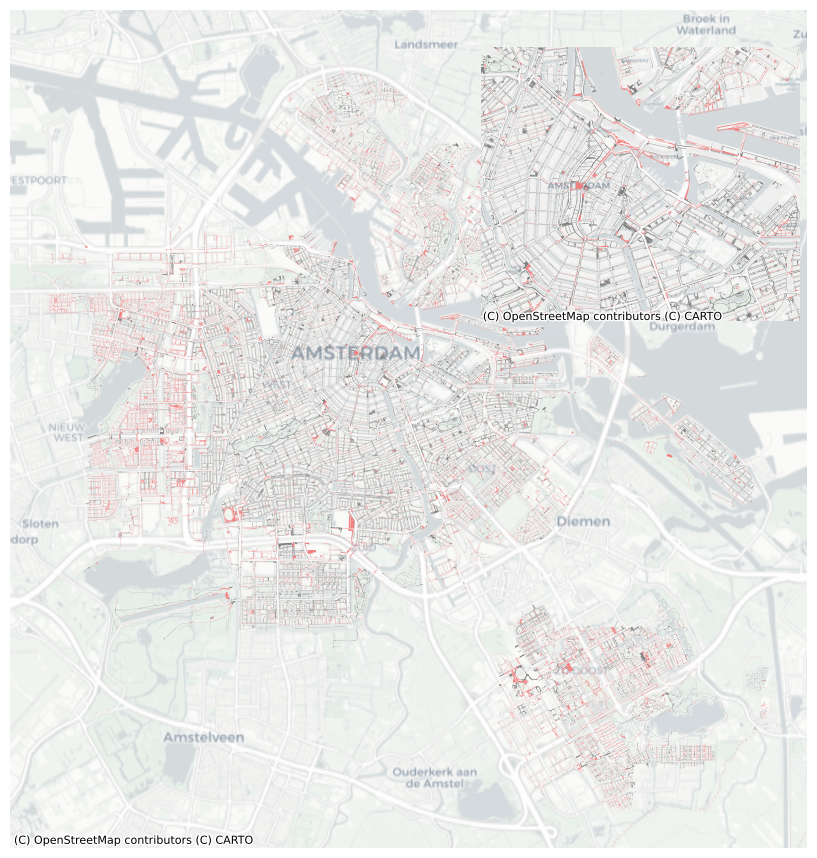

In [40]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as cx
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# Step 1: Filter the 'buurten' GeoDataFrame to get the polygons where 'Stadsdeel' is 'Centrum'
centrum_polygons = buurten[buurten['Stadsdeel'] == 'Centrum']

# Step 2: Get the combined bounds of these polygons
# `total_bounds` returns [minx, miny, maxx, maxy] for the bounding box
x_min_zoomed, y_min_zoomed, x_max_zoomed, y_max_zoomed = centrum_polygons.total_bounds

# Create the plot for low and high shade streets
fig, ax = plt.subplots(figsize=(8.27, 11.69))  # A4 size in inches

# Plot the low and high shade streets
low_shade_streets.plot(ax=ax, color='lightcoral', edgecolor='none')
high_shade_streets.plot(ax=ax, color='gray', edgecolor='none')

# Add CartoDB basemap (Positron) to the main plot
cx.add_basemap(ax, crs=low_shade_streets.crs.to_string(), source=cx.providers.CartoDB.Positron)

# Remove axes for clean output
ax.set_axis_off()

# Create inset map
inset_ax = inset_axes(ax, width="40%", height="40%", loc='upper right')

# Plot the zoomed-in section of low and high shade streets on the inset map
low_shade_streets.plot(ax=inset_ax, color='lightcoral', edgecolor='none')
high_shade_streets.plot(ax=inset_ax, color='gray', edgecolor='none')

# Set the zoomed-in section coordinates for the inset map (modify as needed for your area of interest)
inset_ax.set_xlim([x_min_zoomed, x_max_zoomed])  # Replace with your zoomed-in bounds
inset_ax.set_ylim([y_min_zoomed, y_max_zoomed])  # Replace with your zoomed-in bounds

# Add basemap to the inset map
cx.add_basemap(inset_ax, crs=low_shade_streets.crs.to_string(), source=cx.providers.CartoDB.Positron)

# Remove axes from the inset map
inset_ax.set_axis_off()

# Adjust layout and save the figure
plt.tight_layout()
plt.savefig('../results/figures/240919_low_shade_map_with_inset.png', dpi=300)
plt.show()

#### How many trees needed?

In [8]:
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import Point, Polygon
from shapely.affinity import scale
from shapely.ops import unary_union
from shapely.geometry.polygon import orient
from shapely import plotting
import geopandas as gpd

def plot_polygon(ax, polygon, color, alpha=0.5, label=None):
    """Utility function to plot a polygon on a matplotlib axis."""
    x, y = polygon.exterior.xy
    ax.fill(x, y, color=color, alpha=alpha, label=label)

def canopy_polygon(tree_location, canopy_radius):
    """Create a circular polygon representing the canopy of a tree."""
    return Point(tree_location).buffer(canopy_radius)

def find_new_tree_location(polygon, existing_trees, canopy_radius):
    """
    Find a new tree location that maximizes shade on the polygon and avoids overlap with existing trees.
    """
    boundary = polygon.boundary

    # Generate potential tree locations along the boundary of the polygon
    potential_locations = [boundary.interpolate(distance) for distance in np.linspace(0, boundary.length, num=50)]
    
    # Filter out locations that are too close to existing trees
    safe_locations = []
    for loc in potential_locations:
        too_close = any(loc.distance(Point(tree)) < 2 * canopy_radius for tree in existing_trees)
        if not too_close:
            safe_locations.append(loc)
    
    if not safe_locations:
        return None  # Stop placement if no valid locations
    
    return safe_locations[np.random.randint(len(safe_locations))]  # Pick a random valid location

def estimate_shade_contribution(polygon, tree_location, canopy_radius, overlap_factor=1.0, plot_step=False, plot_final=False):
    """
    Estimate the shade contribution of one tree based on how much of its canopy
    falls within the sidewalk polygon, with optional plotting.
    """
    # Create the canopy polygon
    canopy_poly = canopy_polygon(tree_location, canopy_radius)
    
    # Intersect the canopy with the sidewalk to get actual shaded area
    shade_on_sidewalk = canopy_poly.intersection(polygon)
    
    # Calculate the percentage of the tree's canopy that falls on the sidewalk
    shade_coverage_ratio = shade_on_sidewalk.area / canopy_poly.area
    adjusted_shade_contribution = shade_coverage_ratio * overlap_factor
    
    # Plotting for visualization (optional)
    if plot_step:
        fig, ax = plt.subplots(figsize=(8, 8))
        
        # Plot sidewalk polygon
        plot_polygon(ax, polygon, color='lightgray', label='Sidewalk')
        
        # Plot canopy polygon
        plot_polygon(ax, canopy_poly, color='green', alpha=0.5, label='Canopy')
        
        # Optionally plot the shaded area
        if not shade_on_sidewalk.is_empty:
            plot_polygon(ax, shade_on_sidewalk, color='darkgreen', alpha=0.5, label='Shade on Sidewalk')
        
        ax.set_title("Tree Canopy and Shade Contribution")
        ax.set_xlabel("X Coordinate")
        ax.set_ylabel("Y Coordinate")
        ax.legend(loc='upper right')
        
        # Set limits
        xlim = polygon.bounds[0], polygon.bounds[2]
        ylim = polygon.bounds[1], polygon.bounds[3]
        ax.set_xlim(xlim)
        ax.set_ylim(ylim)
        
        plt.show()
    
    return adjusted_shade_contribution * canopy_poly.area

def calculate_trees_for_shade(polygon, current_shade_percent, target_shade_percent, canopy_radius, overlap_factor=0.8, plot_steps=False, plot_final=False):
    """
    Calculate how many trees are needed to reach the target shade percentage, 
    placing trees smartly and considering canopy overlap.
    """
    polygon_area = polygon.area
    current_shade_area = (current_shade_percent / 100) * polygon_area
    target_shade_area = (target_shade_percent / 100) * polygon_area
    additional_shade_needed = target_shade_area - current_shade_area
    
    trees_added = 0
    total_added_shade = 0
    existing_trees = []

    while total_added_shade < additional_shade_needed:
        # Find a smart location for the next tree
        new_tree_location = find_new_tree_location(polygon, existing_trees, canopy_radius)
        
        if new_tree_location is None:
            print("No more space for non-overlapping trees.")
            break
        
        # Estimate the shade contribution of the new tree
        shade_contribution = estimate_shade_contribution(polygon, new_tree_location, canopy_radius, overlap_factor, plot_steps, plot_final)
        
        # Update total shade and overlap factor
        total_added_shade += shade_contribution
        overlap_factor *= 0.9  # Slightly reduce overlap for future trees
        
        # Add the tree's location to the list
        existing_trees.append(new_tree_location)
        
        trees_added += 1

        if plot_steps:
            # Plot the current state with the newly added tree
            plot_current_state(polygon, existing_trees, canopy_radius, trees_added)
    if plot_final:
        # Final plot showing the sidewalk and all added trees
        plot_final_state(polygon, existing_trees, canopy_radius)
    
    return trees_added

def plot_current_state(polygon, existing_trees, canopy_radius, trees_added):
    """Utility function to plot the current state after each tree addition."""
    fig, ax = plt.subplots(figsize=(8, 8))
    
    # Plot sidewalk polygon
    plot_polygon(ax, polygon, color='lightgray', label='Sidewalk')

    # Plot existing trees and their canopies
    for tree_location in existing_trees:
        canopy_poly = canopy_polygon(tree_location, canopy_radius)
        plot_polygon(ax, canopy_poly, color='green', alpha=0.5)

    ax.set_title(f"Tree Addition Step: {trees_added}")
    ax.set_xlabel("X Coordinate")
    ax.set_ylabel("Y Coordinate")
    
    # Set limits
    xlim = polygon.bounds[0], polygon.bounds[2]
    ylim = polygon.bounds[1], polygon.bounds[3]
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    
    ax.legend(loc='upper right')
    plt.show()

def plot_final_state(polygon, existing_trees, canopy_radius):
    """Utility function to plot the final state after all trees have been added."""
    fig, ax = plt.subplots(figsize=(8, 8))
    
    # Plot sidewalk polygon
    plot_polygon(ax, polygon, color='lightgray', label='Sidewalk')

    # Plot all existing trees and their canopies
    for tree_location in existing_trees:
        canopy_poly = canopy_polygon(tree_location, canopy_radius)
        plot_polygon(ax, canopy_poly, color='green', alpha=0.5)

    ax.set_title("Final State with All Added Trees")
    ax.set_xlabel("X Coordinate")
    ax.set_ylabel("Y Coordinate")
    
    # Set limits
    xlim = polygon.bounds[0], polygon.bounds[2]
    ylim = polygon.bounds[1], polygon.bounds[3]
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    
    ax.legend(loc='upper right')
    plt.show()

def calculate_trees_for_multiple_polygons(gdf, current_shade_column, target_shade_percent, canopy_radius, overlap_factor=0.8, plot_steps=False, plot_final=False):
    """
    Calculate how many trees are needed to reach the target shade percentage for each sidewalk polygon in the GeoDataFrame.

    Parameters:
    - gdf: GeoDataFrame containing polygons (sidewalks).
    - current_shade_column: The column name for current shade percentage.
    - target_shade_percent: The target shade percentage to reach.
    - canopy_radius: The canopy radius of the trees in meters.
    - overlap_factor: Factor to reduce overlap contribution of subsequent trees.
    
    Returns:
    - GeoDataFrame with an additional column for the number of trees required.
    """
    
    def calculate_trees_for_single_polygon(row):
        # Extract the polygon geometry
        row.geometry = row.geometry.buffer(0)  # Buffer to clean up invalid geometries
        polygon = row.geometry
        
        # Extract the current shade percentage for this polygon
        current_shade_percent = row[current_shade_column]
        
        # Calculate number of trees required for this polygon
        num_trees_required = calculate_trees_for_shade(
            polygon, current_shade_percent, target_shade_percent, canopy_radius, overlap_factor, plot_steps=plot_steps, plot_final=plot_final)
        
        return num_trees_required
    
    # Ensure the GeoDataFrame is in EPSG:28992 (Amersfoort / RD New)
    if gdf.crs.to_epsg() != 28992:
        gdf = gdf.to_crs(epsg=28992)

    # Apply the tree calculation to each row in the GeoDataFrame
    gdf['trees_required'] = gdf.apply(calculate_trees_for_single_polygon, axis=1)

    return gdf


In [9]:
# Example usage:
# Define parameters
target_shade_percent = 30
canopy_radius = 3  # Example canopy radius in meters


# Apply to your GeoDataFrame
gdf_with_trees = calculate_trees_for_multiple_polygons(low_shade_streets, '202406_tree_shade_percent_day_average', target_shade_percent, canopy_radius, plot_steps=False, plot_final=False)

No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space for non-overlapping trees.
No more space fo

In [ ]:
# Apply to your GeoDataFrame
add_trees = calculate_trees_for_multiple_polygons(low_shade_streets[50:100], '202406_tree_shade_percent_day_average', target_shade_percent, canopy_radius, plot_steps=False, plot_final=True)

array([[<Axes: title={'center': 'trees_required'}>]], dtype=object)

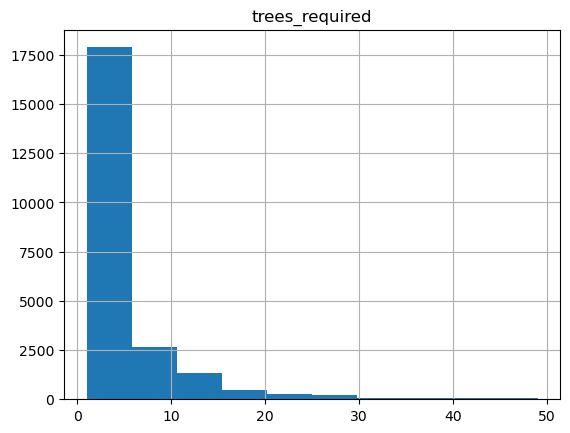

In [30]:
gdf_with_trees.hist(column='trees_required')

In [20]:
high_shade_streets = high_shade_streets.to_crs(28992)

[]

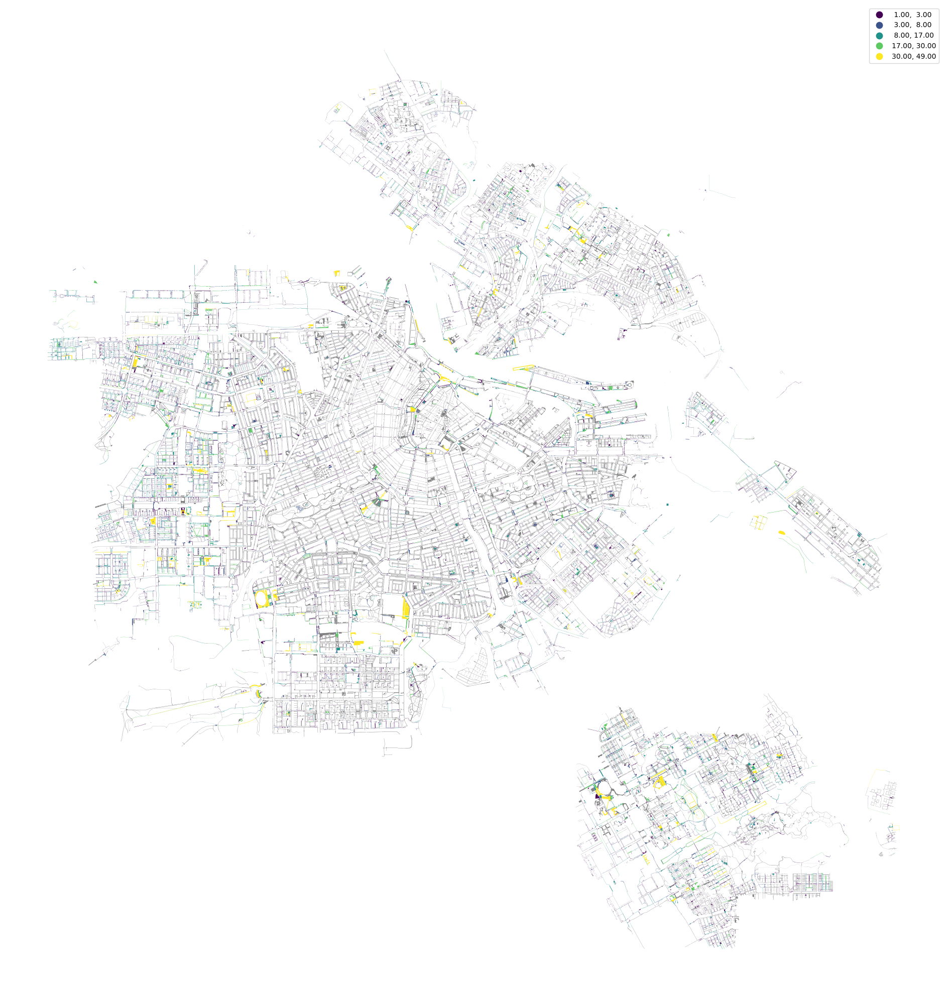

In [21]:


# Plot
# fig, ax = plt.subplots(figsize=(8.27, 11.69))  # A4 size in inches
fig, ax = plt.subplots(figsize=(20, 20)) 
gdf_with_trees.plot(column='trees_required', ax=ax, edgecolor='none',legend=True, scheme='natural_breaks')
high_shade_streets.plot(ax=ax, color='gray', edgecolor='none',)

# Customizing plot for better journal output
ax.set_axis_off()  # Remove axes
plt.tight_layout()
plt.savefig('../results/figures/240924_trees_needed_map.png', dpi=1200)
plt.plot()

In [10]:
gdf_with_trees.trees_required.sum()

100605

### Shade perc per neighbourhood / sociodems

<Axes: >

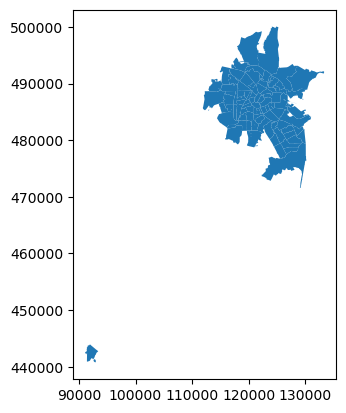

In [63]:
cbs = gpd.read_file('../data/raw_data/cbs/cbs_pc4_2022_v2.gpkg', mask=filtered_gdf)
cbs.plot()

In [64]:
filtered_gdf = filtered_gdf.to_crs(cbs.crs)

In [65]:
filtered_gdf_filtered = filtered_gdf[['geometry','202406_tree_shade_percent_day_average','Buurt','Wijk','Gebied','Stadsdeel']]
filtered_gdf_filtered = gpd.sjoin(filtered_gdf_filtered, cbs, how='left', op='intersects')
filtered_gdf_filtered.reset_index(inplace=True)
filtered_gdf_filtered.head()

/opt/anaconda3/envs/throwing_shade/lib/python3.12/site-packages/IPython/core/interactiveshell.py:3517: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


,index,geometry,202406_tree_shade_percent_day_average,Buurt,Wijk,Gebied,Stadsdeel,index_right,postcode,aantal_inwoners,aantal_mannen,aantal_vrouwen,aantal_inwoners_0_tot_15_jaar,aantal_inwoners_15_tot_25_jaar,aantal_inwoners_25_tot_45_jaar,aantal_inwoners_45_tot_65_jaar,aantal_inwoners_65_jaar_en_ouder,aantal_geboorten,percentage_geb_nederland_herkomst_nederland,percentage_geb_nederland_herkomst_overig_europa,percentage_geb_nederland_herkomst_buiten_europa,percentage_geb_buiten_nederland_herkomst_europa,percentage_geb_buiten_nederland_herkmst_buiten_europa,aantal_part_huishoudens,aantal_eenpersoonshuishoudens,aantal_meerpersoonshuishoudens_zonder_kind,aantal_eenouderhuishoudens,aantal_tweeouderhuishoudens,gemiddelde_huishoudensgrootte,aantal_woningen,aantal_woningen_bouwjaar_voor_1945,aantal_woningen_bouwjaar_45_tot_65,aantal_woningen_bouwjaar_65_tot_75,aantal_woningen_bouwjaar_75_tot_85,aantal_woningen_bouwjaar_85_tot_95,aantal_woningen_bouwjaar_95_tot_05,aantal_woningen_bouwjaar_05_tot_15,aantal_woningen_bouwjaar_15_en_later,aantal_meergezins_woningen,percentage_koopwoningen,percentage_huurwoningen,aantal_huurwoningen_in_bezit_woningcorporaties,aantal_niet_bewoonde_woningen,gemiddelde_woz_waarde_woning,gemiddeld_gasverbruik_woning,gemiddeld_elektriciteitsverbruik_woning,gemiddeld_inkomen_huishouden,percentage_laag_inkomen_huishouden,percentage_hoog_inkomen_huishouden,aantal_personen_met_uitkering_onder_aowlft,dichtstbijzijnde_grote_supermarkt_afstand_in_km,grote_supermarkt_aantal_binnen_1_km,grote_supermarkt_aantal_binnen_3_km,grote_supermarkt_aantal_binnen_5_km,dichtstbijzijnde_winkels_ov_dagel_levensm_afst_in_km,winkels_ov_dagel_levensm_aantal_binnen_1_km,winkels_ov_dagel_levensm_aantal_binnen_3_km,winkels_ov_dagel_levensm_aantal_binnen_5_km,dichtstbijzijnde_warenhuis_afstand_in_km,warenhuis_aantal_binnen_5_km,warenhuis_aantal_binnen_10_km,warenhuis_aantal_binnen_20_km,dichtstbijzijnde_cafe_afstand_in_km,cafe_aantal_binnen_1_km,cafe_aantal_binnen_3_km,cafe_aantal_binnen_5_km,dichtstbijzijnde_cafetaria_afstand_in_km,cafetaria_aantal_binnen_1_km,cafetaria_aantal_binnen_3_km,cafetaria_aantal_binnen_5_km,dichtstbijzijnde_hotel_afstand_in_km,hotel_aantal_binnen_5_km,hotel_aantal_binnen_10_km,hotel_aantal_binnen_20_km,dichtstbijzijnde_restaurant_afstand_in_km,restaurant_aantal_binnen_1_km,restaurant_aantal_binnen_3_km,restaurant_aantal_binnen_5_km,dichtstbijzijnde_buitenschoolse_opvang_afstand_in_km,buitenschoolse_opvang_aantal_binnen_1_km,buitenschoolse_opvang_aantal_binnen_3_km,buitenschoolse_opvang_aantal_binnen_5_km,dichtstbijzijnde_kinderdagverblijf_afstand_in_km,kinderdagverblijf_aantal_binnen_1_km,kinderdagverblijf_aantal_binnen_3_km,kinderdagverblijf_aantal_binnen_5_km,dichtstbijzijnde_brandweerkazerne_afstand_in_km,dichtstbijzijnde_oprit_hoofdverkeersweg_afstand_in_km,dichtstbijzijnde_overstapstation_afstand_in_km,dichtstbijzijnde_treinstation_afstand_in_km,dichtstbijzijnde_attractiepark_afstand_in_km,attractiepark_aantal_binnen_10_km,attractiepark_aantal_binnen_20_km,attractiepark_aantal_binnen_50_km,dichtstbijzijnde_bioscoop_afstand_in_km,bioscoop_aantal_binnen_5_km,bioscoop_aantal_binnen_10_km,bioscoop_aantal_binnen_20_km,dichtstbijzijnde_museum_afstand_in_km,museum_aantal_binnen_5_km,museum_aantal_binnen_10_km,museum_aantal_binnen_20_km,dichtstbijzijnde_theater_afstand_in_km,theater_aantal_binnen_5_km,theater_aantal_binnen_10_km,theater_aantal_binnen_20_km,dichtstbijzijnde_bibliotheek_afstand_in_km,dichtstbijzijnde_kunstijsbaan_afstand_in_km,dichtstbijzijnde_poppodium_afstand_in_km,dichtstbijzijnde_sauna_afstand_in_km,dichtstbijzijnde_zonnebank_afstand_in_km,dichtstbijzijnde_zwembad_afstand_in_km,dichtstbijzijnde_basisonderwijs_afstand_in_km,basisonderwijs_aantal_binnen_1_km,basisonderwijs_aantal_binnen_3_km,basisonderwijs_aantal_binnen_5_km,dichtstbijzijnde_havo_vwo_afstand_in_km,havo_vwo_aantal_binnen_3_km,havo_vwo_aantal_binnen_5_km,havo_vwo_aantal_binnen_10_km,dichtstbijzijnde_vmbo_afstand_in_km,vmbo_aantal_binn

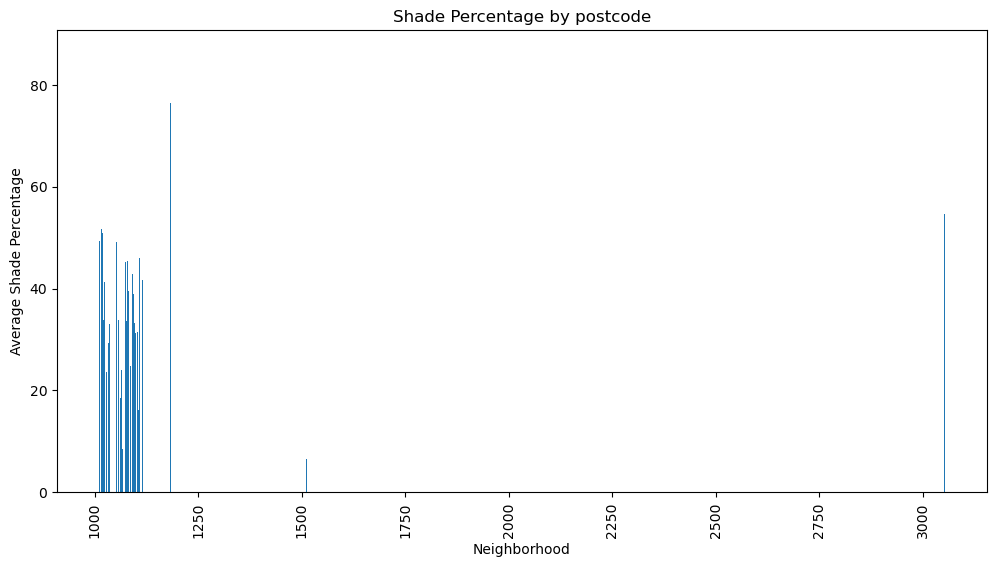

In [66]:
# Neighborhood analysis
postcode_group = filtered_gdf_filtered.groupby('postcode').agg(
    mean_shade_perc=('202406_tree_shade_percent_day_average', 'mean'),
    median_shade_perc = ('202406_tree_shade_percent_day_average', 'median')  # Replace 'shade_column' with the column you're interested in
    ).reset_index()

# # Plot overall distribution
# plt.figure(figsize=(12, 6))
# plt.hist(df_filtered.filter(like='shade').max(axis=1), bins=50, alpha=0.7, label='Shade %')
# plt.axvline(threshold, color='r', linestyle='dashed', linewidth=1, label='Threshold')
# plt.xlabel('Shade Percentage')
# plt.ylabel('Frequency')
# plt.title('Shade Percentage Distribution')
# plt.legend()
# plt.show()

# Plot neighborhood comparison
plt.figure(figsize=(12, 6))
plt.bar(postcode_group['postcode'], postcode_group['mean_shade_perc'])
plt.xlabel('Neighborhood')
plt.ylabel('Average Shade Percentage')
plt.title('Shade Percentage by postcode')
plt.xticks(rotation=90)
plt.show()

In [67]:
# Merge the grouped results with the GeoDataFrame on 'Buurtcode'
postcode_with_stats = cbs.merge(postcode_group, on='postcode', how='left')

# Display the resulting GeoDataFrame
print(postcode_with_stats.head())

   postcode  aantal_inwoners  aantal_mannen  aantal_vrouwen  \
0      1391             8115           3990            4125   
1      1101              140             95              40   
2      1102            24430          12390           12035   
3      1105             2460           1150            1310   
4      1106            17685           8545            9140   

   aantal_inwoners_0_tot_15_jaar  aantal_inwoners_15_tot_25_jaar  \
0                           1615                             855   
1                              5                              20   
2                           3435                            4790   
3                             30                            1160   
4                           2960                            2325   

   aantal_inwoners_25_tot_45_jaar  aantal_inwoners_45_tot_65_jaar  \
0                            1575                            2435   
1                             100                              10   
2    

In [70]:
postcode_with_stats.explore(column='mean_shade_perc')

In [78]:
postcode_with_stats.head()

,postcode,aantal_inwoners,aantal_mannen,aantal_vrouwen,aantal_inwoners_0_tot_15_jaar,aantal_inwoners_15_tot_25_jaar,aantal_inwoners_25_tot_45_jaar,aantal_inwoners_45_tot_65_jaar,aantal_inwoners_65_jaar_en_ouder,aantal_geboorten,percentage_geb_nederland_herkomst_nederland,percentage_geb_nederland_herkomst_overig_europa,percentage_geb_nederland_herkomst_buiten_europa,percentage_geb_buiten_nederland_herkomst_europa,percentage_geb_buiten_nederland_herkmst_buiten_europa,aantal_part_huishoudens,aantal_eenpersoonshuishoudens,aantal_meerpersoonshuishoudens_zonder_kind,aantal_eenouderhuishoudens,aantal_tweeouderhuishoudens,gemiddelde_huishoudensgrootte,aantal_woningen,aantal_woningen_bouwjaar_voor_1945,aantal_woningen_bouwjaar_45_tot_65,aantal_woningen_bouwjaar_65_tot_75,aantal_woningen_bouwjaar_75_tot_85,aantal_woningen_bouwjaar_85_tot_95,aantal_woningen_bouwjaar_95_tot_05,aantal_woningen_bouwjaar_05_tot_15,aantal_woningen_bouwjaar_15_en_later,aantal_meergezins_woningen,percentage_koopwoningen,percentage_huurwoningen,aantal_huurwoningen_in_bezit_woningcorporaties,aantal_niet_bewoonde_woningen,gemiddelde_woz_waarde_woning,gemiddeld_gasverbruik_woning,gemiddeld_elektriciteitsverbruik_woning,gemiddeld_inkomen_huishouden,percentage_laag_inkomen_huishouden,percentage_hoog_inkomen_huishouden,aantal_personen_met_uitkering_onder_aowlft,dichtstbijzijnde_grote_supermarkt_afstand_in_km,grote_supermarkt_aantal_binnen_1_km,grote_supermarkt_aantal_binnen_3_km,grote_supermarkt_aantal_binnen_5_km,dichtstbijzijnde_winkels_ov_dagel_levensm_afst_in_km,winkels_ov_dagel_levensm_aantal_binnen_1_km,winkels_ov_dagel_levensm_aantal_binnen_3_km,winkels_ov_dagel_levensm_aantal_binnen_5_km,dichtstbijzijnde_warenhuis_afstand_in_km,warenhuis_aantal_binnen_5_km,warenhuis_aantal_binnen_10_km,warenhuis_aantal_binnen_20_km,dichtstbijzijnde_cafe_afstand_in_km,cafe_aantal_binnen_1_km,cafe_aantal_binnen_3_km,cafe_aantal_binnen_5_km,dichtstbijzijnde_cafetaria_afstand_in_km,cafetaria_aantal_binnen_1_km,cafetaria_aantal_binnen_3_km,cafetaria_aantal_binnen_5_km,dichtstbijzijnde_hotel_afstand_in_km,hotel_aantal_binnen_5_km,hotel_aantal_binnen_10_km,hotel_aantal_binnen_20_km,dichtstbijzijnde_restaurant_afstand_in_km,restaurant_aantal_binnen_1_km,restaurant_aantal_binnen_3_km,restaurant_aantal_binnen_5_km,dichtstbijzijnde_buitenschoolse_opvang_afstand_in_km,buitenschoolse_opvang_aantal_binnen_1_km,buitenschoolse_opvang_aantal_binnen_3_km,buitenschoolse_opvang_aantal_binnen_5_km,dichtstbijzijnde_kinderdagverblijf_afstand_in_km,kinderdagverblijf_aantal_binnen_1_km,kinderdagverblijf_aantal_binnen_3_km,kinderdagverblijf_aantal_binnen_5_km,dichtstbijzijnde_brandweerkazerne_afstand_in_km,dichtstbijzijnde_oprit_hoofdverkeersweg_afstand_in_km,dichtstbijzijnde_overstapstation_afstand_in_km,dichtstbijzijnde_treinstation_afstand_in_km,dichtstbijzijnde_attractiepark_afstand_in_km,attractiepark_aantal_binnen_10_km,attractiepark_aantal_binnen_20_km,attractiepark_aantal_binnen_50_km,dichtstbijzijnde_bioscoop_afstand_in_km,bioscoop_aantal_binnen_5_km,bioscoop_aantal_binnen_10_km,bioscoop_aantal_binnen_20_km,dichtstbijzijnde_museum_afstand_in_km,museum_aantal_binnen_5_km,museum_aantal_binnen_10_km,museum_aantal_binnen_20_km,dichtstbijzijnde_theater_afstand_in_km,theater_aantal_binnen_5_km,theater_aantal_binnen_10_km,theater_aantal_binnen_20_km,dichtstbijzijnde_bibliotheek_afstand_in_km,dichtstbijzijnde_kunstijsbaan_afstand_in_km,dichtstbijzijnde_poppodium_afstand_in_km,dichtstbijzijnde_sauna_afstand_in_km,dichtstbijzijnde_zonnebank_afstand_in_km,dichtstbijzijnde_zwembad_afstand_in_km,dichtstbijzijnde_basisonderwijs_afstand_in_km,basisonderwijs_aantal_binnen_1_km,basisonderwijs_aantal_binnen_3_km,basisonderwijs_aantal_binnen_5_km,dichtstbijzijnde_havo_vwo_afstand_in_km,havo_vwo_aantal_binnen_3_km,havo_vwo_aantal_binnen_5_km,havo_vwo_aantal_binnen_10_km,dichtstbijzijnde_vmbo_afstand_in_km,vmbo_aantal_binnen_3_km,vmbo_aantal_binnen_5_km,vmbo_aantal_binnen_10_km,dichtstbijzijnde_voortgezet_onderwij

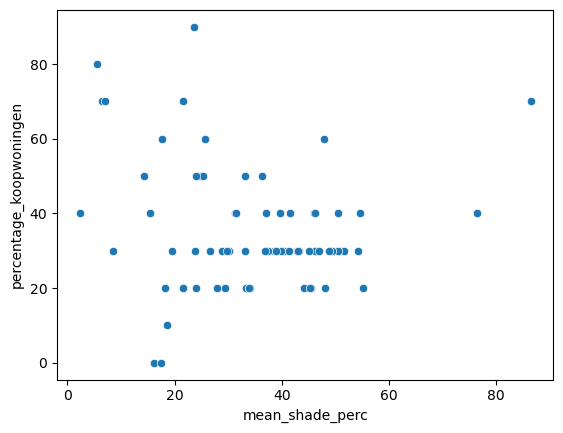

In [80]:
postcode_with_stats = postcode_with_stats.loc[postcode_with_stats.mean_shade_perc>=0]
postcode_with_stats = postcode_with_stats.loc[postcode_with_stats.aantal_inwoners>=0]
postcode_with_stats = postcode_with_stats.loc[postcode_with_stats.percentage_koopwoningen>=0]
# Create a scatterplot
sns.scatterplot(data=postcode_with_stats, x='mean_shade_perc', y='percentage_koopwoningen')

# Show the plot
plt.show()

### Shade per neighbourhood / sociodemographics

In [28]:

threshold = 30

# Find polygons above or below the threshold
polygons_above_threshold = filtered_gdf[filtered_gdf['20240620_tree_shade_percent_at_1530'] > threshold]
polygons_below_threshold = filtered_gdf[filtered_gdf['20240620_tree_shade_percent_at_1530'] <= threshold]

# Neighborhood analysis
neighborhood_group = filtered_gdf.groupby('Stadsdeel').agg({
    'tree_shade_percent_at_1530': 'mean'  # Replace 'shade_column' with the column you're interested in
}).reset_index()

# # Plot overall distribution
# plt.figure(figsize=(12, 6))
# plt.hist(df_filtered.filter(like='shade').max(axis=1), bins=50, alpha=0.7, label='Shade %')
# plt.axvline(threshold, color='r', linestyle='dashed', linewidth=1, label='Threshold')
# plt.xlabel('Shade Percentage')
# plt.ylabel('Frequency')
# plt.title('Shade Percentage Distribution')
# plt.legend()
# plt.show()

# Plot neighborhood comparison
plt.figure(figsize=(12, 6))
plt.bar(neighborhood_group['Stadsdeel'], neighborhood_group['240620_tree_shade_percent_at_1530'])
plt.xlabel('Neighborhood')
plt.ylabel('Average Shade Percentage')
plt.title('Shade Percentage by Neighborhood')
plt.xticks(rotation=90)
plt.show()


KeyError: "Column(s) ['tree_shade_percent_at_1530'] do not exist"

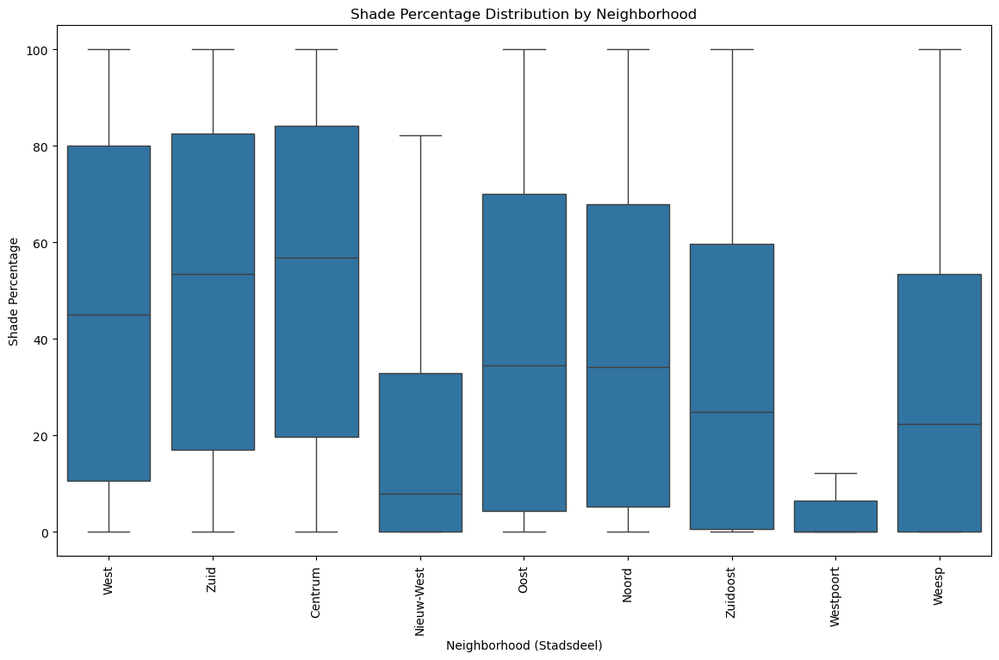

In [8]:
# Create a boxplot for shade percentage distribution by stadsdeel
plt.figure(figsize=(14, 8))
sns.boxplot(x='Stadsdeel', y='tree_shade_percent_at_1530', data=filtered_gdf, showfliers=False)
plt.xlabel('Neighborhood (Stadsdeel)')
plt.ylabel('Shade Percentage')
plt.title('Shade Percentage Distribution by Neighborhood')
# plt.ylim(0, 100)  # Set y-axis limits to 0% to 100%
plt.xticks(rotation=90)  # Rotate x labels if needed
plt.show()

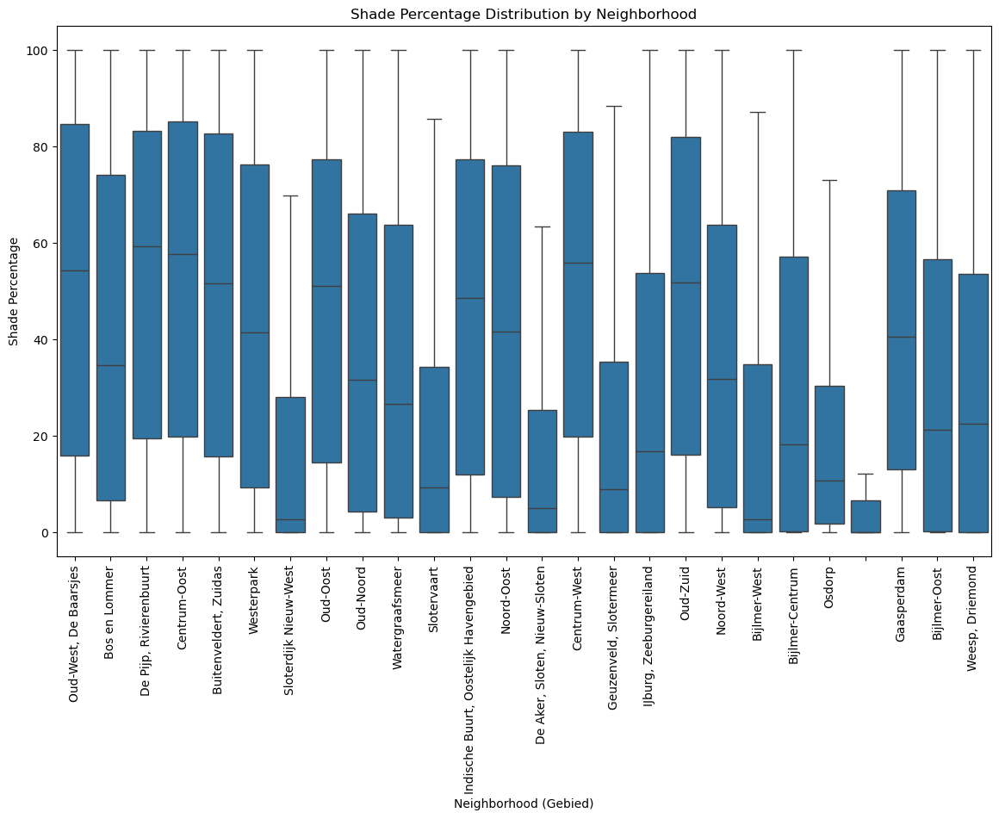

In [9]:
# Create a boxplot for shade percentage distribution by stadsdeel
plt.figure(figsize=(14, 8))
sns.boxplot(x='Gebied', y='tree_shade_percent_at_1530', data=filtered_gdf, showfliers=False)
plt.xlabel('Neighborhood (Gebied)')
plt.ylabel('Shade Percentage')
plt.title('Shade Percentage Distribution by Neighborhood')
# plt.ylim(0, 100)  # Set y-axis limits to 0% to 100%
plt.xticks(rotation=90)  # Rotate x labels if needed
plt.show()

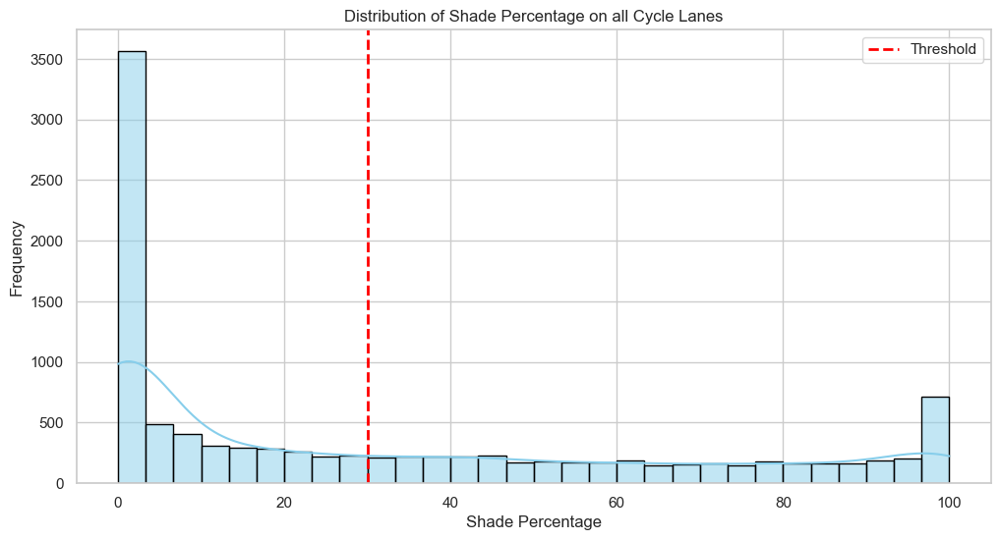

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_shade_histogram(df, column, bins=30, color='skyblue'):
    """
    Plot a histogram of shade percentage using Seaborn.

    Parameters:
    - df: DataFrame containing the shade percentage column.
    - column: Name of the column to plot.
    - bins: Number of bins in the histogram (default is 30).
    - color: Color of the histogram bars (default is 'skyblue').

    Returns:
    - None
    """
    # Set Seaborn style
    sns.set(style='whitegrid')

    # Create the histogram
    plt.figure(figsize=(12, 6))
    sns.histplot(df[column], bins=bins, color=color, kde=True, edgecolor='black')

    # Add vertical line for threshold (if needed)
    threshold = 30  # Adjust this threshold as needed
    plt.axvline(threshold, color='red', linestyle='dashed', linewidth=2, label='Threshold')

    # Customize plot
    plt.xlabel('Shade Percentage')
    plt.ylabel('Frequency')
    plt.title(f'Distribution of Shade Percentage on all Cycle Lanes')
    plt.legend()
    plt.grid(True)

    # Show the plot
    plt.show()

# Example usage with a DataFrame for cycling
plot_shade_histogram(cycling, 'tree_shade_percent_at_1530')

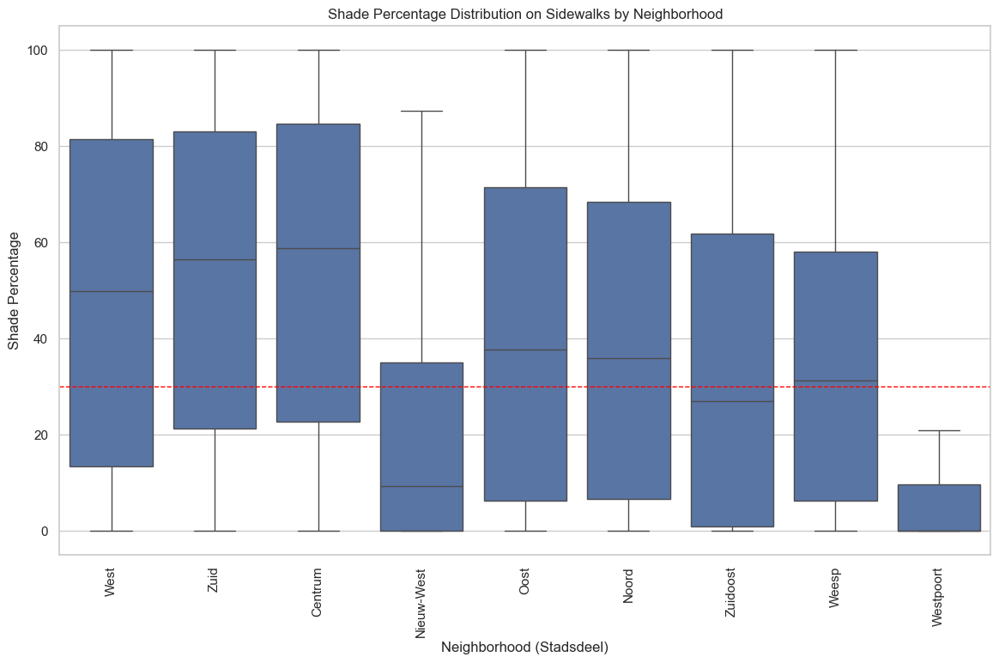

In [ ]:
# Create a boxplot for shade percentage distribution by stadsdeel
plt.figure(figsize=(14, 8))
sns.boxplot(x='Stadsdeel', y='tree_shade_percent_at_1530', data=sidewalks, showfliers=False)
plt.xlabel('Neighborhood (Stadsdeel)')
plt.ylabel('Shade Percentage')
plt.title('Shade Percentage Distribution on Sidewalks by Neighborhood')
# Add vertical line for threshold (if needed)
threshold = 30  # Adjust this threshold as needed
plt.axhline(threshold, color='red', linestyle='dashed', linewidth=1, label='Threshold')
# plt.ylim(0, 100)  # Set y-axis limits to 0% to 100%
plt.xticks(rotation=90)  # Rotate x labels if needed
plt.show()

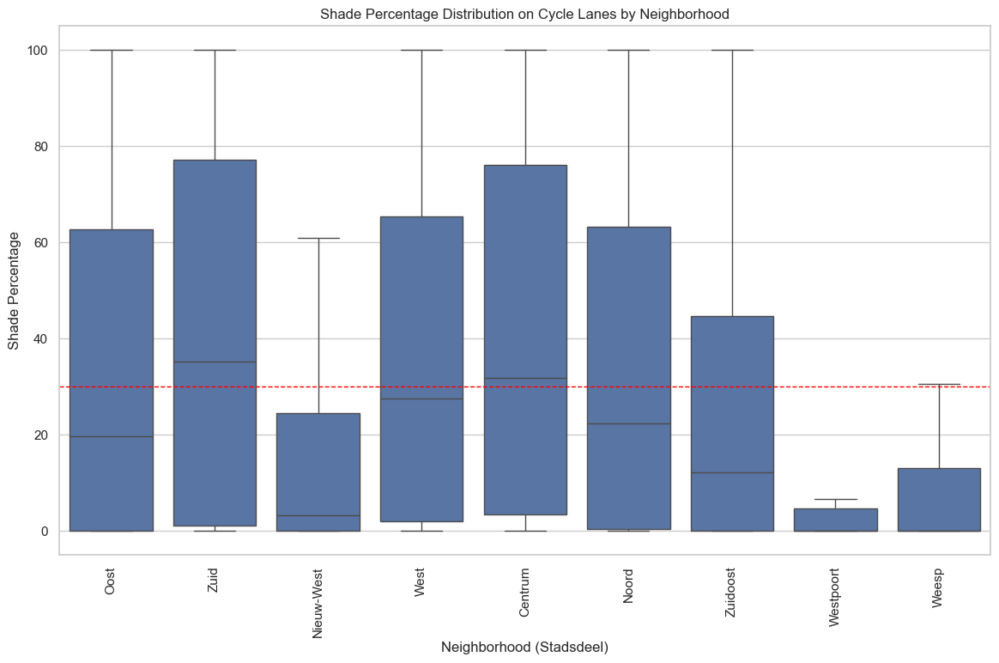

In [ ]:
# Create a boxplot for shade percentage distribution by stadsdeel
plt.figure(figsize=(14, 8))
sns.boxplot(x='Stadsdeel', y='tree_shade_percent_at_1530', data=cycling, showfliers=False)
plt.xlabel('Neighborhood (Stadsdeel)')
plt.ylabel('Shade Percentage')
plt.title('Shade Percentage Distribution on Cycle Lanes by Neighborhood')
# Add vertical line for threshold (if needed)
threshold = 30  # Adjust this threshold as needed
plt.axhline(threshold, color='red', linestyle='dashed', linewidth=1, label='Threshold')
# plt.ylim(0, 100)  # Set y-axis limits to 0% to 100%
plt.xticks(rotation=90)  # Rotate x labels if needed
plt.show()

### Shade per surface type per season over time

In [ ]:
# Create a boxplot for shade percentage distribution by stadsdeel
plt.figure(figsize=(14, 8))
sns.boxplot(x='Stadsdeel', y='tree_shade_percent_at_1530', data=filtered_gdf, showfliers=False)
plt.xlabel('Neighborhood (Stadsdeel)')
plt.ylabel('Shade Percentage')
plt.title('Shade Percentage Distribution by Neighborhood')
# plt.ylim(0, 100)  # Set y-axis limits to 0% to 100%
plt.xticks(rotation=90)  # Rotate x labels if needed
plt.show()

In [49]:
def plot_shade_statistics(df, time_increments, column_prefix='tree_shade_percent_at_', title='Average and Median Shade Percentage Over Time'):
    """
    Plot the average and median shade percentages over time.

    Parameters:
    - df: DataFrame containing the shade percentage columns.
    - time_increments: List of time increments to plot.
    - column_prefix: Prefix for the column names containing shade percentages (default is 'tree_shade_percent_at_').

    Returns:
    - None
    """
    # Calculate average and median shade percentage for each time increment
    average_shade_per_time = {}
    median_shade_per_time = {}
    for time in time_increments:
        column_name = f'{column_prefix}{time}'
        if column_name in df.columns:
            average_shade_per_time[time] = df[column_name].mean()
            median_shade_per_time[time] = df[column_name].median()

    # Convert to DataFrames for easier plotting
    average_shade_df = pd.DataFrame(list(average_shade_per_time.items()), columns=['Time', 'Average Shade Percentage'])
    median_shade_df = pd.DataFrame(list(median_shade_per_time.items()), columns=['Time', 'Median Shade Percentage'])

        # Add vertical line for threshold (if needed)


    # Plot the line graph
    plt.figure(figsize=(12, 8))
    plt.plot(average_shade_df['Time'], average_shade_df['Average Shade Percentage'], marker='o', label='Average Shade Percentage')
    plt.plot(median_shade_df['Time'], median_shade_df['Median Shade Percentage'], marker='x', linestyle='--', label='Median Shade Percentage')
    plt.ylim(bottom=0)
    threshold = 30  # Adjust this threshold as needed
    plt.axhline(threshold, color='red', linestyle='dashed', linewidth=1, label='Minimum Threshold')
    plt.xlabel('Time')
    plt.ylabel('Shade Percentage')
    plt.title(title)
    plt.grid(True)
    plt.xticks(rotation=45)  # Rotate x labels if needed
    plt.legend()
    plt.show()



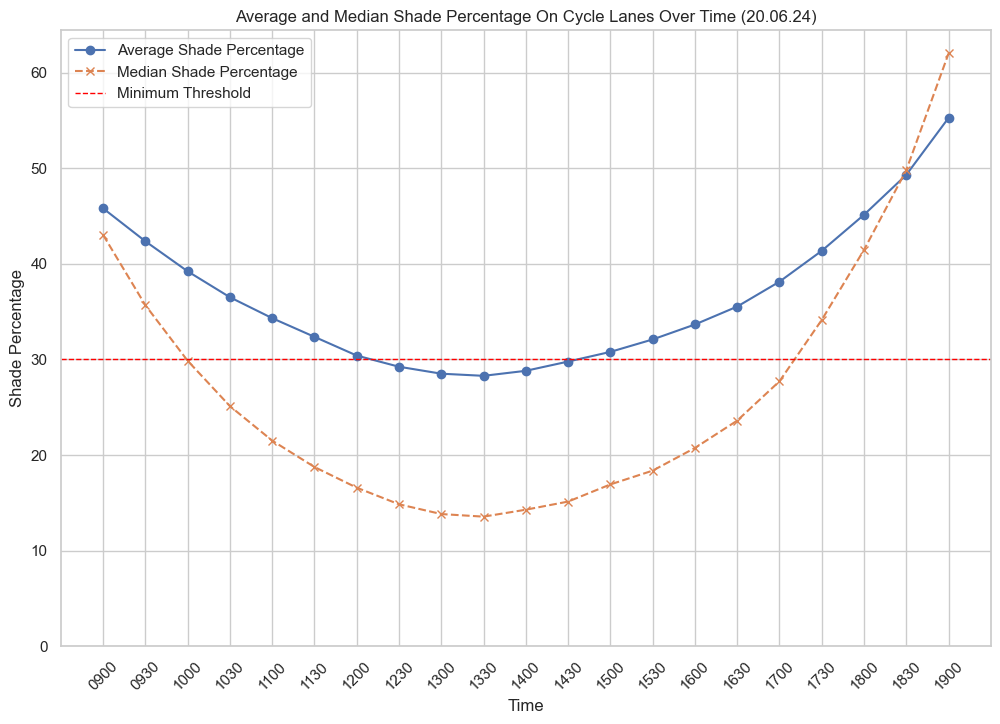

In [50]:

# Example usage with a DataFrame for cycling
time_increments = ['0900', '0930', '1000', '1030', '1100', '1130', '1200', '1230', '1300', '1330', '1400', '1430', '1500', '1530', '1600', '1630', '1700', '1730', '1800', '1830', '1900']
# Replace 'cycling_df' with your actual DataFrame
plot_shade_statistics(cycling, time_increments, title='Average and Median Shade Percentage On Cycle Lanes Over Time (20.06.24)')


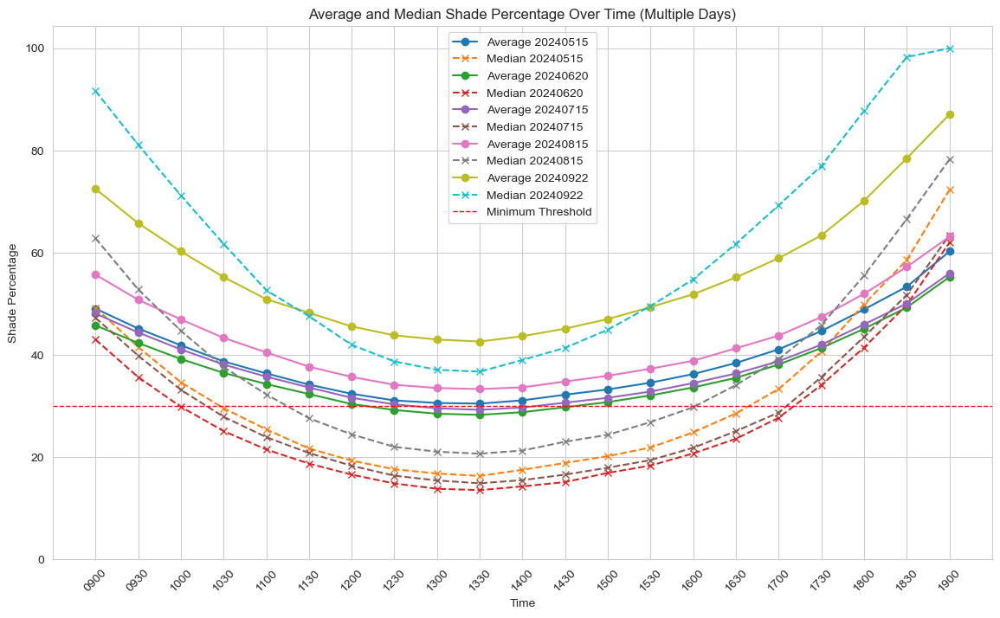

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def plot_shade_statistics(df, dates, time_increments, column_prefix='tree_shade_percent_at_', title='Average and Median Shade Percentage Over Time'):
    """
    Plot the average and median shade percentages over time for multiple dates.

    Parameters:
    - df: DataFrame containing the shade percentage columns.
    - dates: List of dates to plot for each date.
    - time_increments: List of time increments to plot.
    - column_prefix: Prefix for the column names containing shade percentages (default is 'tree_shade_percent_at_').
    - title: Title of the plot.

    Returns:
    - None
    """
    plt.figure(figsize=(14, 8))
    
    # Iterate over each date and plot the statistics
    for date in dates:
        average_shade_per_time = {}
        median_shade_per_time = {}
        
        for time in time_increments:
            column_name = f'{date}_{column_prefix}{time}'
            if column_name in df.columns:
                average_shade_per_time[time] = df[column_name].mean()
                median_shade_per_time[time] = df[column_name].median()

        # Convert to DataFrames for easier plotting
        average_shade_df = pd.DataFrame(list(average_shade_per_time.items()), columns=['Time', 'Average Shade Percentage'])
        median_shade_df = pd.DataFrame(list(median_shade_per_time.items()), columns=['Time', 'Median Shade Percentage'])

        # Plot the average and median for each date
        plt.plot(average_shade_df['Time'], average_shade_df['Average Shade Percentage'], marker='o', label=f'Average {date}')
        plt.plot(median_shade_df['Time'], median_shade_df['Median Shade Percentage'], marker='x', linestyle='--', label=f'Median {date}')
    
    # Customize the plot
    plt.ylim(bottom=0)  # Ensure y-axis starts at 0
    threshold = 30  # Adjust this threshold as needed
    plt.axhline(threshold, color='red', linestyle='dashed', linewidth=1, label='Minimum Threshold')
    plt.xlabel('Time')
    plt.ylabel('Shade Percentage')
    plt.title(title)
    plt.grid(True)
    plt.xticks(rotation=45)  # Rotate x labels if needed
    plt.legend()
    plt.show()

# List of dates to plot
dates = ['20240515', '20240620', '20240715', '20240815', '20240922']

# Example usage with a DataFrame for cycling
time_increments = ['0900', '0930', '1000', '1030', '1100', '1130', '1200', '1230', '1300', '1330', '1400', '1430', '1500', '1530', '1600', '1630', '1700', '1730', '1800', '1830', '1900']

# Replace 'cycling' with your actual DataFrame
plot_shade_statistics(cycling, dates, time_increments, title='Average and Median Shade Percentage Over Time (Multiple Days)')

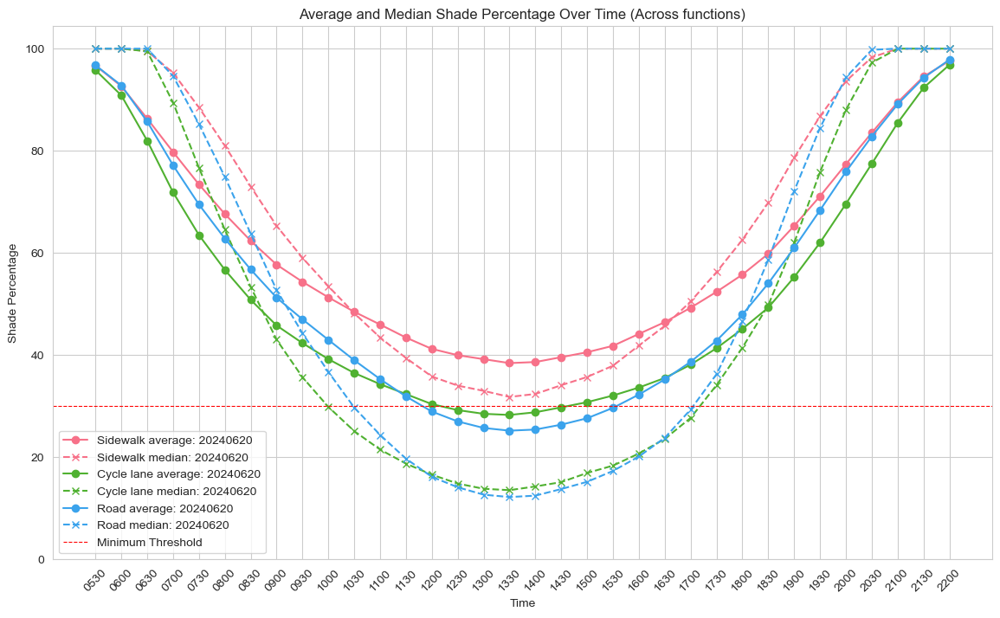

In [23]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

def plot_shade_statistics_per_function(df, functions, dates, time_increments, column_prefix='tree_shade_percent_at_', title='Average and Median Shade Percentage Over Time'):
    """
    Plot the average and median shade percentages over time for multiple dates.

    Parameters:
    - df: DataFrame containing the shade percentage columns.
    - functions: List of surface types according to Gebruiksfunctie.
    - dates: List of dates to plot for each date.
    - time_increments: List of time increments to plot.
    - column_prefix: Prefix for the column names containing shade percentages (default is 'tree_shade_percent_at_').
    - title: Title of the plot.

    Returns:
    - None
    """
    plt.figure(figsize=(14, 8))
    
    # Assign a unique color for each function
    colors = sns.color_palette("husl", len(functions))

    for idx, function in enumerate(functions):
        subset = df.loc[df['Gebruiksfunctie'] == function]
        color = colors[idx]  # Use the color assigned to this function

        # Iterate over each date and plot the statistics
        for date in dates:
            average_shade_per_time = {}
            median_shade_per_time = {}
            
            for time in time_increments:
                column_name = f'{date}_{column_prefix}{time}'
                if column_name in subset.columns:
                    average_shade_per_time[time] = subset[column_name].mean()
                    median_shade_per_time[time] = subset[column_name].median()

            # Convert to DataFrames for easier plotting
            average_shade_df = pd.DataFrame(list(average_shade_per_time.items()), columns=['Time', 'Average Shade Percentage'])
            median_shade_df = pd.DataFrame(list(median_shade_per_time.items()), columns=['Time', 'Median Shade Percentage'])

            # Plot the average and median for each date using the same color
            plt.plot(average_shade_df['Time'], average_shade_df['Average Shade Percentage'], marker='o', label=f'{function} average: {date}', color=color)
            plt.plot(median_shade_df['Time'], median_shade_df['Median Shade Percentage'], marker='x', linestyle='--', label=f'{function} median: {date}', color=color)
    
    # Customize the plot
    plt.ylim(bottom=0)  # Ensure y-axis starts at 0
    threshold = 30  # Adjust this threshold as needed
    plt.axhline(threshold, color='red', linestyle='dashed', linewidth=0.8, label='Minimum Threshold')
    plt.xlabel('Time')
    plt.ylabel('Shade Percentage')
    plt.title(title)
    plt.grid(True)
    plt.xticks(rotation=45)  # Rotate x labels if needed
    plt.legend()
    plt.show()

# List of functions (surface types)
functions = ['Sidewalk', 'Cycle lane', 'Road']

# List of dates to plot
dates = ['20240620']

# Example usage with a DataFrame
time_increments = ['0530','0600','0630','0700','0730','0800','0830','0900', '0930', '1000', '1030', '1100', '1130', '1200', '1230', '1300', '1330', '1400', '1430', '1500', '1530', '1600', '1630', '1700', '1730', '1800', '1830', '1900', '1930', '2000', '2030', '2100', '2130', '2200']

# Replace 'filtered_gdf' with your actual DataFrame
plot_shade_statistics_per_function(filtered_gdf, functions, dates, time_increments, title='Average and Median Shade Percentage Over Time (Across functions)')

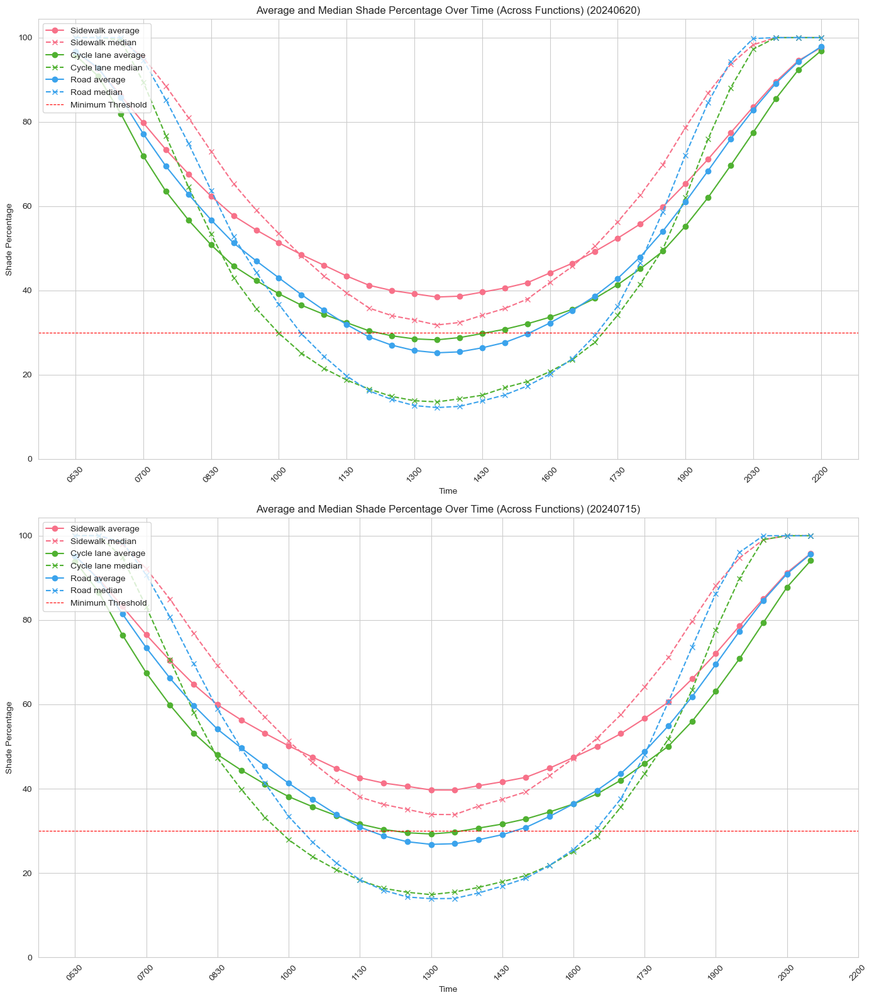

In [27]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

def plot_shade_statistics_per_function(df, functions, dates, time_increments, column_prefix='tree_shade_percent_at_', title='Average and Median Shade Percentage Over Time'):
    """
    Plot the average and median shade percentages over time for multiple dates, with each date in a separate subplot.

    Parameters:
    - df: DataFrame containing the shade percentage columns.
    - functions: List of surface types according to Gebruiksfunctie.
    - dates: List of dates to plot for each date.
    - time_increments: List of time increments to plot.
    - column_prefix: Prefix for the column names containing shade percentages (default is 'tree_shade_percent_at_').
    - title: Title of the plot.

    Returns:
    - None
    """
    n_dates = len(dates)  # Number of dates to plot
    fig, axes = plt.subplots(n_dates, 1, figsize=(14, 8 * n_dates))  # Create subplots

    # If only one date, 'axes' is not an array, so we wrap it in a list for consistent iteration
    if n_dates == 1:
        axes = [axes]

    # Assign a unique color for each function
    colors = sns.color_palette("husl", len(functions))

    for i, date in enumerate(dates):
        ax = axes[i]  # Select subplot for this date

        for idx, function in enumerate(functions):
            subset = df.loc[df['Gebruiksfunctie'] == function]
            color = colors[idx]  # Use the color assigned to this function

            average_shade_per_time = {}
            median_shade_per_time = {}

            for time in time_increments:
                column_name = f'{date}_{column_prefix}{time}'
                if column_name in subset.columns:
                    average_shade_per_time[time] = subset[column_name].mean()
                    median_shade_per_time[time] = subset[column_name].median()

            # Convert to DataFrames for easier plotting
            average_shade_df = pd.DataFrame(list(average_shade_per_time.items()), columns=['Time', 'Average Shade Percentage'])
            median_shade_df = pd.DataFrame(list(median_shade_per_time.items()), columns=['Time', 'Median Shade Percentage'])

            # Plot the average and median for each function
            ax.plot(average_shade_df['Time'], average_shade_df['Average Shade Percentage'], marker='o', label=f'{function} average', color=color)
            ax.plot(median_shade_df['Time'], median_shade_df['Median Shade Percentage'], marker='x', linestyle='--', label=f'{function} median', color=color)
        
        # Customize each subplot
        ax.set_ylim(bottom=0)  # Ensure y-axis starts at 0
        ax.axhline(30, color='red', linestyle='dashed', linewidth=0.8, label='Minimum Threshold')
        ax.set_xlabel('Time')
        ax.set_ylabel('Shade Percentage')
        ax.set_title(f'{title} ({date})')
        ax.grid(True)
        ax.legend(loc='upper left')
        ax.set_xticks(range(0, len(time_increments), 3))  # Adjust tick frequency
        ax.set_xticklabels(time_increments[::3], rotation=45)  # Rotate x labels if needed

    plt.tight_layout()  # Adjust spacing between subplots
    plt.show()

# List of functions (surface types)
functions = ['Sidewalk', 'Cycle lane', 'Road']

# List of dates to plot
dates = ['20240620', '20240715']

# Example usage with a DataFrame
time_increments = ['0530','0600','0630','0700','0730','0800','0830','0900', '0930', '1000', '1030', '1100', '1130', '1200', '1230', '1300', '1330', '1400', '1430', '1500', '1530', '1600', '1630', '1700', '1730', '1800', '1830', '1900', '1930', '2000', '2030', '2100', '2130', '2200']

# Replace 'filtered_gdf' with your actual DataFrame
plot_shade_statistics_per_function(filtered_gdf, functions, dates, time_increments, title='Average and Median Shade Percentage Over Time (Across Functions)')

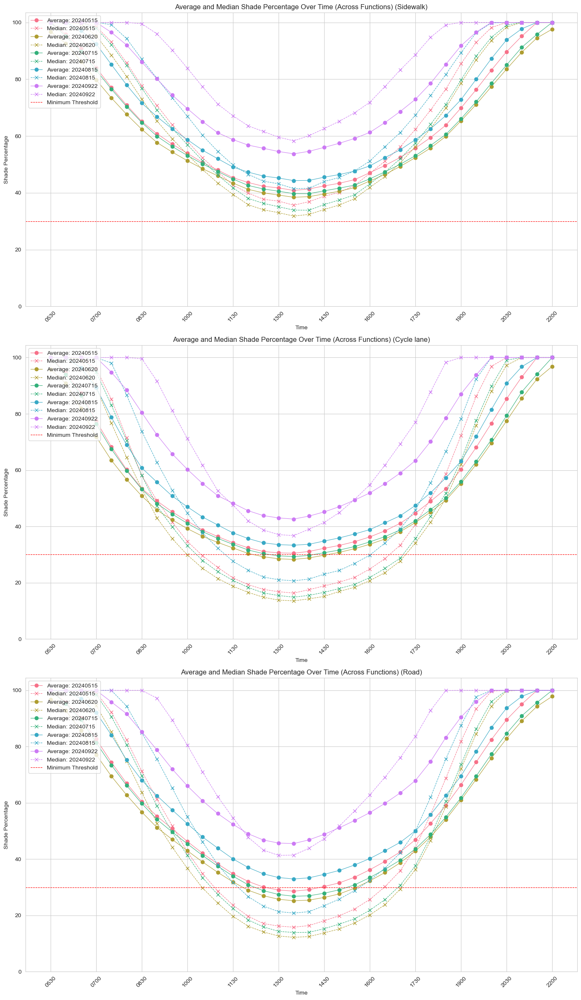

In [43]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

def plot_shade_statistics_per_function(df, functions, dates, time_increments, column_prefix='tree_shade_percent_at_', title='Average and Median Shade Percentage Over Time'):
    """
    Plot the average and median shade percentages over time for multiple functions, with each function in a separate subplot.

    Parameters:
    - df: DataFrame containing the shade percentage columns.
    - functions: List of surface types according to Gebruiksfunctie.
    - dates: List of dates to plot for each function.
    - time_increments: List of time increments to plot.
    - column_prefix: Prefix for the column names containing shade percentages (default is 'tree_shade_percent_at_').
    - title: Title of the plot.

    Returns:
    - None
    """
    n_functions = len(functions)  # Number of functions to plot

    fig, axes = plt.subplots(n_functions, figsize=(14, 8 * n_functions))  # Create subplots for each function

    # If only one function, 'axes' is not an array, so we wrap it in a list for consistent iteration
    if n_functions == 1:
        axes = [axes]

    # Assign a unique color for each date
    colors = sns.color_palette("husl", len(dates))

    for i, function in enumerate(functions):
        ax = axes[i]  # Select subplot for this function

        subset = df.loc[df['Gebruiksfunctie'] == function]

        for idx, date in enumerate(dates):
            color = colors[idx]  # Use the color assigned to this date

            average_shade_per_time = {}
            median_shade_per_time = {}

            for time in time_increments:
                column_name = f'{date}_{column_prefix}{time}'
                if column_name in subset.columns:
                    average_shade_per_time[time] = subset[column_name].mean()
                    median_shade_per_time[time] = subset[column_name].median()
                else:
                    average_shade_per_time[time] = 100
                    median_shade_per_time[time] = 100

            # Convert to DataFrames for easier plotting
            average_shade_df = pd.DataFrame(list(average_shade_per_time.items()), columns=['Time', 'Average Shade Percentage'])
            median_shade_df = pd.DataFrame(list(median_shade_per_time.items()), columns=['Time', 'Median Shade Percentage'])

            # Plot the average and median for each date
            ax.plot(average_shade_df['Time'], average_shade_df['Average Shade Percentage'], marker='o', linewidth=0.8, label=f'Average: {date}', color=color)
            ax.plot(median_shade_df['Time'], median_shade_df['Median Shade Percentage'], marker='x', linestyle='--', linewidth=0.8,label=f'Median: {date}', color=color)

        # Customize each subplot
        ax.set_ylim(bottom=0)  # Ensure y-axis starts at 0
        ax.axhline(30, color='red', linestyle='dashed', linewidth=0.8, label='Minimum Threshold')
        ax.set_xlabel('Time')
        ax.set_ylabel('Shade Percentage')
        ax.set_title(f'{title} ({function})')
        ax.grid(True)
        ax.legend(loc='upper left')
        ax.set_xticks(range(0, len(time_increments), 3))  # Adjust tick frequency
        ax.set_xticklabels(time_increments[::3], rotation=45)  # Rotate x labels if needed

    plt.tight_layout()  # Adjust spacing between subplots
    plt.show()

# List of functions (surface types)
functions = ['Sidewalk', 'Cycle lane', 'Road']

# List of dates to plot
dates = ['20240515','20240620', '20240715','20240815','20240922']

# Example usage with a DataFrame
time_increments = ['0530','0600','0630','0700','0730','0800','0830','0900', '0930', '1000', '1030', '1100', '1130', '1200', '1230', '1300', '1330', '1400', '1430', '1500', '1530', '1600', '1630', '1700', '1730', '1800', '1830', '1900', '1930', '2000', '2030', '2100', '2130', '2200']

# Replace 'filtered_gdf' with your actual DataFrame
plot_shade_statistics_per_function(filtered_gdf, functions, dates, time_increments, title='Average and Median Shade Percentage Over Time (Across Functions)')

Plot saved at ../results/figures/240918_shade_percent_across_functions_and_time.png


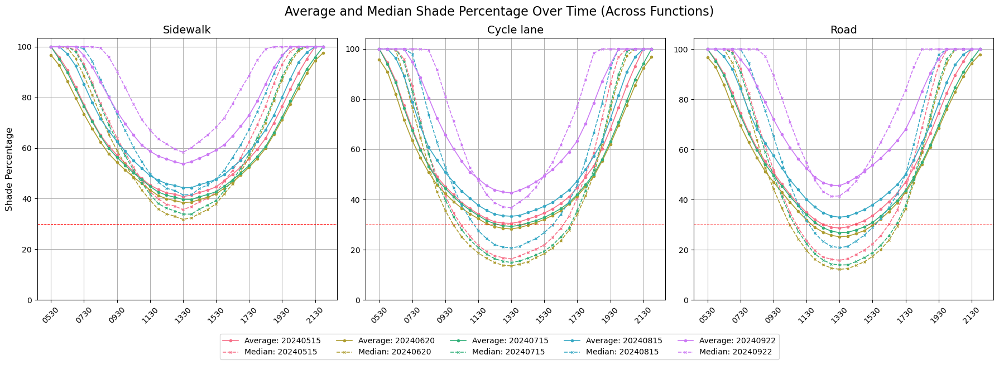

In [22]:
def plot_shade_statistics_per_function(df, functions, dates, time_increments, column_prefix='tree_shade_percent_at_', title='Average and Median Shade Percentage Over Time', save_path=None, file_name=None):
    """
    Plot the average and median shade percentages over time for multiple functions in a one-row, three-column layout with a single shared legend.

    Parameters:
    - df: DataFrame containing the shade percentage columns.
    - functions: List of surface types according to Gebruiksfunctie.
    - dates: List of dates to plot for each function.
    - time_increments: List of time increments to plot.
    - column_prefix: Prefix for the column names containing shade percentages (default is 'tree_shade_percent_at_').
    - title: Title of the plot.

    Returns:
    - None
    """
    n_functions = len(functions)  # Number of functions to plot
    n_cols = 3  # Ensure a three-column layout
    n_rows = 1  # Single row for the layout
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 6), squeeze=False)  # Adjust the figure size for better readability
    axes = axes.flatten()  # Flatten the axes array for easier iteration

    # Assign a unique color for each date
    colors = sns.color_palette("husl", len(dates))
    
    # Keep track of line objects and labels for shared legend
    lines = []
    labels = []

    for i, function in enumerate(functions):
        ax = axes[i]  # Select subplot for this function

        subset = df.loc[df['Gebruiksfunctie'] == function]

        for idx, date in enumerate(dates):
            color = colors[idx]  # Use the color assigned to this date

            average_shade_per_time = {}
            median_shade_per_time = {}

            for time in time_increments:
                column_name = f'{date}_{column_prefix}{time}'
                if column_name in subset.columns:
                    average_shade_per_time[time] = subset[column_name].mean()
                    median_shade_per_time[time] = subset[column_name].median()
                else:
                    average_shade_per_time[time] = 100
                    median_shade_per_time[time] = 100

            # Convert to DataFrames for easier plotting
            average_shade_df = pd.DataFrame(list(average_shade_per_time.items()), columns=['Time', 'Average Shade Percentage'])
            median_shade_df = pd.DataFrame(list(median_shade_per_time.items()), columns=['Time', 'Median Shade Percentage'])

            # Plot the average and median for each date
            line_avg, = ax.plot(average_shade_df['Time'], average_shade_df['Average Shade Percentage'], marker='o', markersize=3, linewidth=1.2, label=f'Average: {date}', color=color)
            line_med, = ax.plot(median_shade_df['Time'], median_shade_df['Median Shade Percentage'], marker='x', markersize=3, linestyle='--', linewidth=1.2, label=f'Median: {date}', color=color)

            if i == 0:  # Only add labels from the first subplot
                lines.append(line_avg)
                lines.append(line_med)
                labels.append(f'Average: {date}')
                labels.append(f'Median: {date}')

        # Customize each subplot for legibility
        ax.set_ylim(bottom=0)
        ax.axhline(30, color='red', linestyle='dashed', linewidth=0.8, label='Minimum Threshold')
        # ax.set_xlabel('Time', fontsize=12)  # Larger font size for axis labels
        if i == 0:  # Only the first plot gets a y-axis label
            ax.set_ylabel('Shade Percentage', fontsize=12)
        else:
            ax.set_ylabel('')  # Remove y-axis label for other plots
        ax.set_title(f'{function}', fontsize=14)  # Larger and descriptive titles
        ax.grid(True)
        ax.set_xticks(range(0, len(time_increments), 4))  # Adjust tick frequency for clarity
        ax.set_xticklabels(time_increments[::4], rotation=45, fontsize=10)  # Rotate and size x labels for better readability
        ax.tick_params(axis='y', labelsize=10)  # Larger tick labels for y-axis

    # Add a single shared legend outside of the plot
    fig.legend(lines, labels, loc='lower center', bbox_to_anchor=(0.5, -0.09), ncol=len(dates), fontsize=10)

    plt.suptitle(title, fontsize=16)  # Main title with larger font
    plt.tight_layout(rect=[0, 0, 1, 1.01])  # Adjust layout to prevent overlapping
    
    # Save the plot if the path and file name are provided
    if save_path and file_name:
        # Ensure the save directory exists
        os.makedirs(save_path, exist_ok=True)
        full_path = os.path.join(save_path, f"{file_name}.png")
        plt.savefig(full_path, bbox_inches='tight', facecolor=fig.get_facecolor())
        print(f"Plot saved at {full_path}")
    plt.show()

# List of functions (surface types)
functions = ['Sidewalk', 'Cycle lane', 'Road']

# List of dates to plot
dates = ['20240515', '20240620', '20240715', '20240815', '20240922']

# Example usage with a DataFrame
time_increments = ['0530', '0600', '0630', '0700', '0730', '0800', '0830', '0900', '0930', '1000', '1030', '1100', '1130', '1200', '1230', '1300', '1330', '1400', '1430', '1500', '1530', '1600', '1630', '1700', '1730', '1800', '1830', '1900', '1930', '2000', '2030', '2100', '2130', '2200']

# Replace 'filtered_gdf' with your actual DataFrame
plot_shade_statistics_per_function(filtered_gdf, functions, dates, time_increments, title='Average and Median Shade Percentage Over Time (Across Functions)',save_path='../results/figures/', file_name='240918_shade_percent_across_functions_and_time')

Plot saved at ../results/figures/240919_shade_percent_across_functions_and_time.png


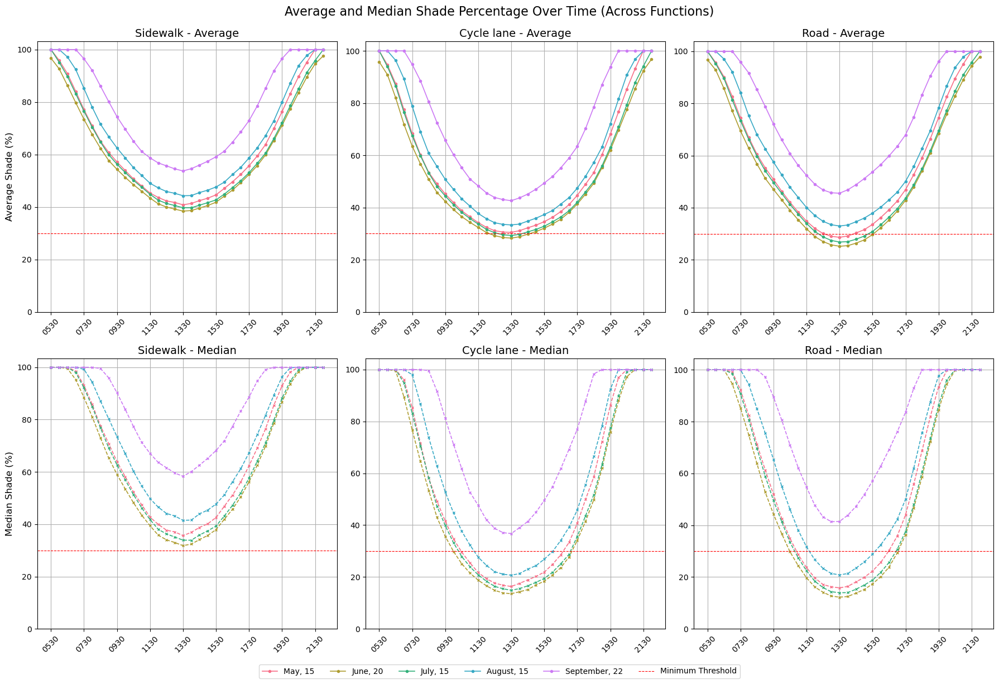

In [32]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import os
from datetime import datetime as dt

def plot_shade_statistics_per_function_disaggregated(df, functions, dates, time_increments, column_prefix='tree_shade_percent_at_', title='Average and Median Shade Percentage Over Time', save_path=None, file_name=None):
    """
    Plot the average and median shade percentages over time for multiple functions.
    Average plots are shown in the first row, median plots in the second row.
    The legend shows the dates with colors.

    Parameters:
    - df: DataFrame containing the shade percentage columns.
    - functions: List of surface types according to Gebruiksfunctie.
    - dates: List of dates to plot for each function.
    - time_increments: List of time increments to plot.
    - column_prefix: Prefix for the column names containing shade percentages (default is 'tree_shade_percent_at_').
    - title: Title of the plot.

    Returns:
    - None
    """
    n_functions = len(functions)  # Number of functions to plot
    n_cols = 3  # Ensure a three-column layout
    n_rows = 2  # Two rows: one for average, one for median
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 12), squeeze=False)  # Adjust the figure size
    axes = axes.flatten()  # Flatten the axes array for easier iteration

    # Assign a unique color for each date
    colors = sns.color_palette("husl", len(dates))
    
    # Keep track of line objects and labels for shared legend
    lines = []
    labels = []

    for i, function in enumerate(functions):
        # Select the subplot for the average (first row)
        ax_avg = axes[i]
        # Select the subplot for the median (second row)
        ax_med = axes[i + n_cols]

        subset = df.loc[df['Gebruiksfunctie'] == function]

        for idx, date in enumerate(dates):
            color = colors[idx]  # Use the color assigned to this date

            # Reformat the date from 'YYYYMMDD' to 'Month, Day'
            formatted_date = dt.strptime(date, '%Y%m%d').strftime('%B, %d')

            average_shade_per_time = {}
            median_shade_per_time = {}

            for time in time_increments:
                column_name = f'{date}_{column_prefix}{time}'
                if column_name in subset.columns:
                    average_shade_per_time[time] = subset[column_name].mean()
                    median_shade_per_time[time] = subset[column_name].median()
                else:
                    average_shade_per_time[time] = 100
                    median_shade_per_time[time] = 100

            # Convert to DataFrames for easier plotting
            average_shade_df = pd.DataFrame(list(average_shade_per_time.items()), columns=['Time', 'Average Shade Percentage'])
            median_shade_df = pd.DataFrame(list(median_shade_per_time.items()), columns=['Time', 'Median Shade Percentage'])

            # Plot the average for each date in the first row
            line_avg, = ax_avg.plot(average_shade_df['Time'], average_shade_df['Average Shade Percentage'], marker='o', markersize=3, linewidth=1.2, color=color)

            # Plot the median for each date in the second row
            line_med, = ax_med.plot(median_shade_df['Time'], median_shade_df['Median Shade Percentage'], marker='x', markersize=3, linestyle='--', linewidth=1.2, color=color)

            if i == 0:  # Only add labels from the first function plot
                lines.append(line_avg)
                labels.append(formatted_date)

        # Customize the average subplot
        ax_avg.set_ylim(bottom=0)
        threshold_line_avg = ax_avg.axhline(30, color='red', linestyle='dashed', linewidth=0.8, label='Minimum Threshold')
        if i == 0:
            ax_avg.set_ylabel('Average Shade (%)', fontsize=12)
        ax_avg.set_title(f'{function} - Average', fontsize=14)
        ax_avg.grid(True)
        ax_avg.set_xticks(range(0, len(time_increments), 4))
        ax_avg.set_xticklabels(time_increments[::4], rotation=45, fontsize=10)
        ax_avg.tick_params(axis='y', labelsize=10)

        # Customize the median subplot
        ax_med.set_ylim(bottom=0)
        ax_med.axhline(30, color='red', linestyle='dashed', linewidth=0.8)
        if i == 0:
            ax_med.set_ylabel('Median Shade (%)', fontsize=12)
            lines.append(threshold_line_avg)  # Add to legend
            labels.append('Minimum Threshold')
        ax_med.set_title(f'{function} - Median', fontsize=14)
        ax_med.grid(True)
        ax_med.set_xticks(range(0, len(time_increments), 4))
        ax_med.set_xticklabels(time_increments[::4], rotation=45, fontsize=10)
        ax_med.tick_params(axis='y', labelsize=10)

    # Add a single shared legend for the dates, outside of the plot
    fig.legend(lines, labels, loc='lower center', bbox_to_anchor=(0.5, -0.03), ncol=(len(dates)+1), fontsize=10)

    plt.suptitle(title, fontsize=16)  # Main title
    plt.tight_layout(rect=[0, 0, 1, 0.99])  # Adjust layout to prevent overlap
    
    # Save the plot if the path and file name are provided
    if save_path and file_name:
        os.makedirs(save_path, exist_ok=True)
        full_path = os.path.join(save_path, f"{file_name}.png")
        plt.savefig(full_path, bbox_inches='tight', facecolor=fig.get_facecolor())
        print(f"Plot saved at {full_path}")
    plt.show()

# Example usage remains the same
# Replace 'filtered_gdf' with your actual DataFrame
plot_shade_statistics_per_function_disaggregated(filtered_gdf, functions, dates, time_increments, title='Average and Median Shade Percentage Over Time (Across Functions)',save_path='../results/figures/', file_name='240919_shade_percent_across_functions_and_time')

### Shade on market areas

In [65]:
winkel = gpd.read_file('../data/raw_data/ams/winkelgebieden all 2024-08-28 14.16.13.geojson')
# Check for invalid geometries in gdf_cleaned and winkel
# filtered_gdf['is_valid'] = gdf_cleaned.is_valid
winkel['is_valid'] = winkel.is_valid

# print(gdf_cleaned.is_valid.all())  # Should return True if all geometries are valid
print(winkel.is_valid.all())       # Should return True if all geometries are valid

# # Fix invalid geometries by applying a small buffer (buffer(0) is a common trick)
# filtered_gdf['geometry'] = filtered_gdf.geometry.buffer(0)
winkel['geometry'] = winkel.geometry.buffer(0)


# Assuming gdf1 and gdf2 are your two GeoDataFrames
# Ensure both have the same CRS (Coordinate Reference System)
winkel = winkel.to_crs(filtered_gdf.crs)

# Perform a spatial join to compare geometries
winkel_surfaces = filtered_gdf[filtered_gdf.geometry.apply(lambda x: any(x.within(g) for g in winkel.geometry))]


True


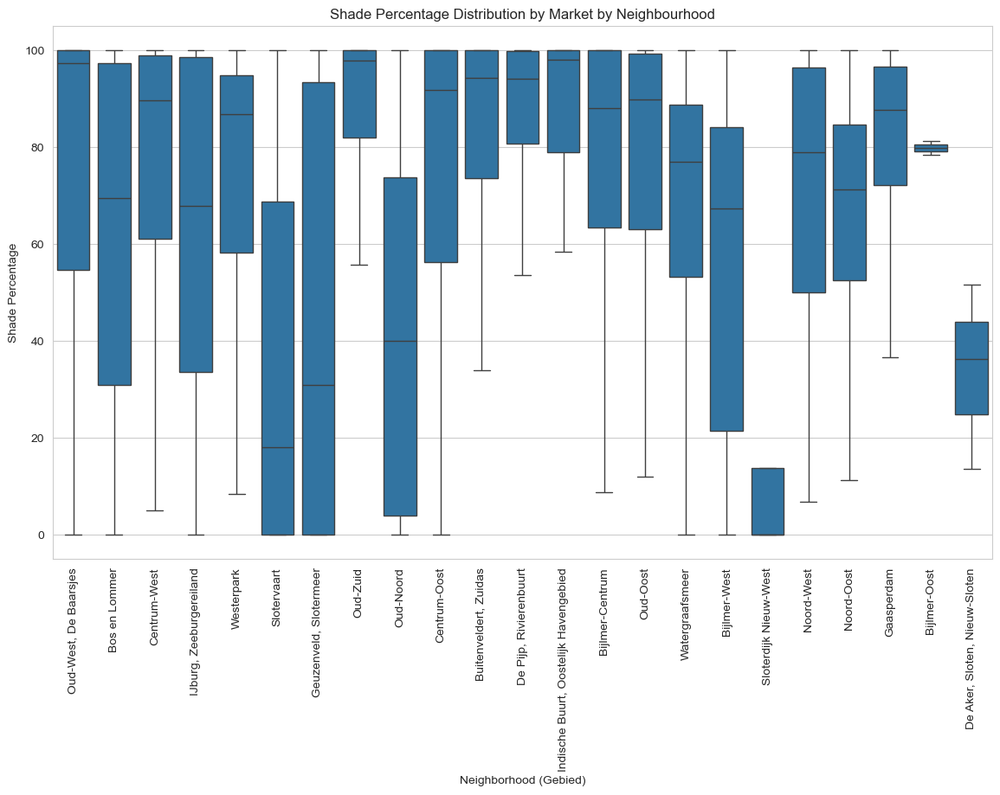

In [68]:
# Create a boxplot for shade percentage distribution by stadsdeel
plt.figure(figsize=(14, 8))
sns.boxplot(x='Gebied', y='tree_shade_percent_at_1530', data=winkel_surfaces, showfliers=False)
plt.xlabel('Neighborhood (Gebied)')
plt.ylabel('Shade Percentage')
plt.title('Shade Percentage Distribution by Market by Neighbourhood')
# plt.ylim(0, 100)  # Set y-axis limits to 0% to 100%
plt.xticks(rotation=90)  # Rotate x labels if needed
plt.show()

### Statistical exploration:

- whole study area
- per neighbourhood
- neighbourhoods grouped by income

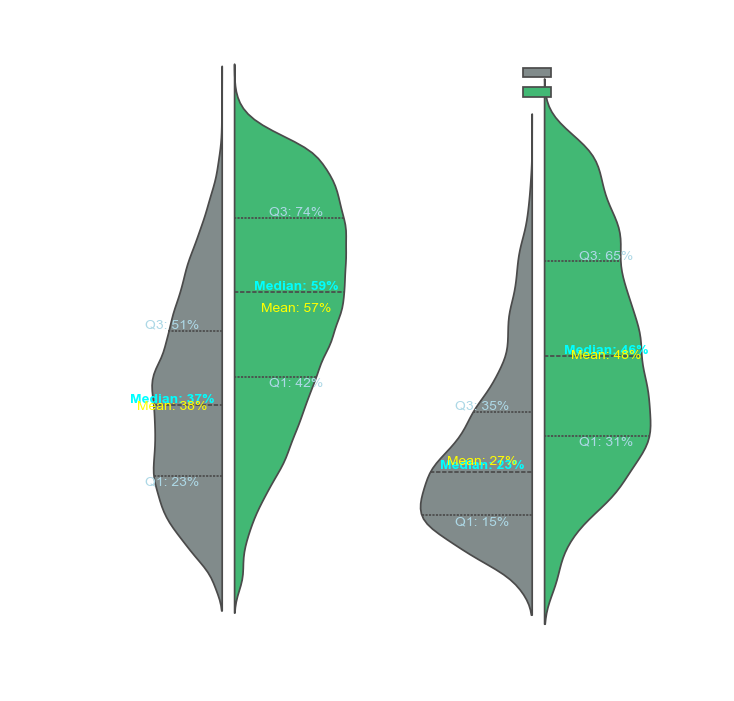

In [30]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'filtered_melt' is already defined with 'Gebruiksfunctie', 'value', and 'Category' columns

# Set the style to match the first plot
sns.set_style("darkgrid")

# Create the figure for the boxplot
fig, ax = plt.subplots(figsize=(8, 8))

# Reuse the custom palette from the first plot
palette = {'Buildings only': '#7f8c8d', 'Buildings and trees': '#2ecc71'}  # Grey and Green

# Create the boxplot with the custom palette
sns.violinplot(x='Gebruiksfunctie', y='value', hue='Category', data=filtered_melt, palette=palette, ax=ax, split=True, gap=.1, inner="quart")

# Get the unique metrics and categories
metrics = filtered_melt['Gebruiksfunctie'].unique()
categories = filtered_melt['Category'].unique()

# Annotate each violin plot
for i, (metric, category) in enumerate([(m, c) for m in metrics for c in categories]):
    # Get the subset of data for the current metric and category
    subset = filtered_melt[(filtered_melt['Gebruiksfunctie'] == metric) & (filtered_melt['Category'] == category)]['value']
    if subset.empty:
        continue
    
    # Calculate statistics
    median_value = np.median(subset)
    mean_value = np.mean(subset)
    q1, q3 = np.percentile(subset, [25, 75])
    min_value = np.min(subset)
    max_value = np.max(subset)
    
    # Calculate the x position of the box
    # Each category has two violin plots, so we need to position correctly
    metric_index = metrics.tolist().index(metric)
    category_index = categories.tolist().index(category)
    x_position = metric_index + (category_index * 0.4) - 0.18  # Adjust for left or right

    if round(median_value, 2) == round(mean_value, 2):
        # Annotate the violin plot with percentage format
        ax.text(x_position, median_value, f'Mean/\nmedian: \n{median_value*100:.0f}%', ha='center', va='bottom', color='cyan', fontsize=10, weight='bold')
        ax.text(x_position, q1, f'Q1: {q1*100:.0f}%', ha='center', va='top', color='lightblue', fontsize=10)
        ax.text(x_position, q3, f'Q3: {q3*100:.0f}%', ha='center', va='bottom', color='lightblue', fontsize=10)
    else: 
        # Annotate the violin plot with percentage format
        ax.text(x_position, median_value, f'Median: {median_value*100:.0f}%', ha='center', va='bottom', color='cyan', fontsize=10, weight='bold')
        ax.text(x_position, mean_value, f'Mean: {mean_value*100:.0f}%', ha='center', va='top', color='yellow', fontsize=10)
        ax.text(x_position, q1, f'Q1: {q1*100:.0f}%', ha='center', va='top', color='lightblue', fontsize=10)
        ax.text(x_position, q3, f'Q3: {q3*100:.0f}%', ha='center', va='bottom', color='lightblue', fontsize=10)


# Customize the plot title and axis labels to match the first plot
ax.set_title('Comparison of Mean Shade Values across Surface Functions', color='white', fontsize=18)
ax.set_xlabel('Function', color='white')
ax.set_ylabel('Daily Shade', color='white')

# Convert y-axis to percentage
ax.yaxis.set_major_formatter(mticker.FuncFormatter(lambda y, _: f'{y*100:.0f}%'))


# Customize the axes
ax.spines['top'].set_color('white')
ax.spines['right'].set_color('white')
ax.spines['left'].set_color('white')
ax.spines['bottom'].set_color('white')
ax.tick_params(axis='x', colors='white')
ax.tick_params(axis='y', colors='white')

# Adjust the legend to match the first plot
legend = ax.legend(title='Category', frameon=False, loc='upper right')
plt.setp(legend.get_title(), color='white')
for text in legend.get_texts():
    text.set_color('white')

# Set the face color of the plot area to match the first plot
ax.set_facecolor('none')
plt.gcf().patch.set_alpha(0)

# Show the plot
plt.show()

In [31]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.ticker as mticker

def plot_violin_with_annotations(filtered_melt, light_background=False, save_path=None, df_name=None):
    """
    Create a violin plot with annotations for mean, median, Q1, and Q3 values.

    Parameters:
    - filtered_melt (DataFrame): DataFrame containing 'Gebruiksfunctie', 'value', and 'Category' columns.
    - light_background (bool): Set to True for a light background version of the plot. Default is False.
    """
    
    # Set the style depending on the background choice
    if light_background:
        sns.set_style("whitegrid")
        title_color = 'black'
        label_color = 'black'
        text_color = 'black'
        palette = {'Buildings only': '#7f8c8d', 'Buildings and trees': '#2ecc71'}
        mean_color = 'blue'
        median_color = 'darkred'
        q1_q3_color = 'gray'
    else:
        sns.set_style("darkgrid")
        title_color = 'white'
        label_color = 'white'
        text_color = 'white'
        palette = {'Buildings only': '#7f8c8d', 'Buildings and trees': '#2ecc71'}
        mean_color = 'yellow'
        median_color = 'cyan'
        q1_q3_color = 'lightblue'
    
    # Create the figure for the boxplot
    fig, ax = plt.subplots(figsize=(8, 8))
    
    # Create the violin plot with the custom palette
    sns.violinplot(x='Gebruiksfunctie', y='value', hue='Category', data=filtered_melt, 
                   palette=palette, ax=ax, split=True, gap=.1, inner="quart")
    
    # Get the unique metrics and categories
    metrics = filtered_melt['Gebruiksfunctie'].unique()
    categories = filtered_melt['Category'].unique()

    # Annotate each violin plot
    for i, (metric, category) in enumerate([(m, c) for m in metrics for c in categories]):
        # Get the subset of data for the current metric and category
        subset = filtered_melt[(filtered_melt['Gebruiksfunctie'] == metric) & (filtered_melt['Category'] == category)]['value']
        if subset.empty:
            continue
        
        # Calculate statistics
        median_value = np.median(subset)
        mean_value = np.mean(subset)
        q1, q3 = np.percentile(subset, [25, 75])
        
        # Calculate the x position of the box
        metric_index = metrics.tolist().index(metric)
        category_index = categories.tolist().index(category)
        x_position = metric_index + (category_index * 0.4) - 0.18  # Adjust for left or right

        if round(median_value, 2) == round(mean_value, 2):
            ax.text(x_position, median_value, f'Mean/\nmedian: \n{median_value*100:.0f}%', ha='center', 
                    va='bottom', color=median_color, fontsize=10, weight='bold')
            ax.text(x_position, q1, f'Q1: {q1*100:.0f}%', ha='center', va='top', color=q1_q3_color, fontsize=10)
            ax.text(x_position, q3, f'Q3: {q3*100:.0f}%', ha='center', va='bottom', color=q1_q3_color, fontsize=10)
        else: 
            ax.text(x_position, median_value, f'Median: {median_value*100:.0f}%', ha='center', 
                    va='bottom', color=median_color, fontsize=10, weight='bold')
            ax.text(x_position, mean_value, f'Mean: {mean_value*100:.0f}%', ha='center', 
                    va='top', color=mean_color, fontsize=10)
            ax.text(x_position, q1, f'Q1: {q1*100:.0f}%', ha='center', va='top', color=q1_q3_color, fontsize=10)
            ax.text(x_position, q3, f'Q3: {q3*100:.0f}%', ha='center', va='bottom', color=q1_q3_color, fontsize=10)

    # Customize the plot title and axis labels
    ax.set_title('Comparison of Mean Shade Values across Surface Functions', color=title_color, fontsize=18)
    ax.set_xlabel('Function', color=label_color)
    ax.set_ylabel('Daily Shade', color=label_color)

    # Convert y-axis to percentage
    ax.yaxis.set_major_formatter(mticker.FuncFormatter(lambda y, _: f'{y*100:.0f}%'))

    # Customize the axes
    ax.spines['top'].set_color(label_color)
    ax.spines['right'].set_color(label_color)
    ax.spines['left'].set_color(label_color)
    ax.spines['bottom'].set_color(label_color)
    ax.tick_params(axis='x', colors=label_color)
    ax.tick_params(axis='y', colors=label_color)

    # Adjust the legend
    legend = ax.legend(title='Category', frameon=False, loc='upper right')
    plt.setp(legend.get_title(), color=text_color)
    for text in legend.get_texts():
        text.set_color(text_color)

    # Set the face color of the plot area
    ax.set_facecolor('none')
    if not light_background:
        plt.gcf().patch.set_alpha(0)\

        # Save the plot if a save_path is provided
    if save_path:
        # Get the current date
        current_date = dt.now().strftime('%-y%m%d')
        # Create the full save path with the current date and dataframe name
        filename = f"{current_date}_{df_name}_plot.png"
        full_save_path = os.path.join(save_path, filename)
        
        # Ensure the directory exists
        os.makedirs(os.path.dirname(full_save_path), exist_ok=True)
        plt.savefig(full_save_path)
        print(f"Plot saved to {full_save_path}")

    # Show the plot
    plt.show()

Plot saved to ../results/figures/240826_day_comparison_plot.png


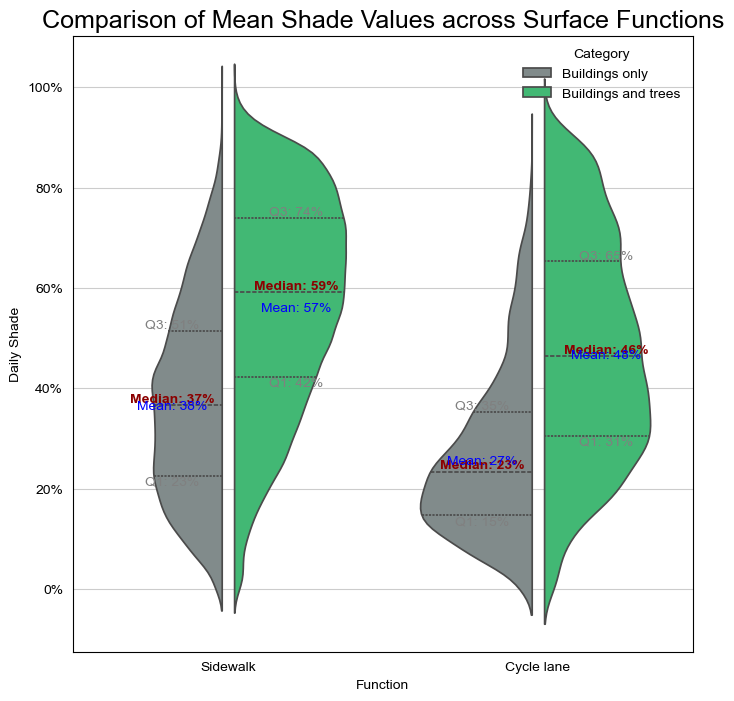

In [102]:
plot_violin_with_annotations(filtered_melt, light_background=True, save_path='../results/figures/', df_name='day_comparison')

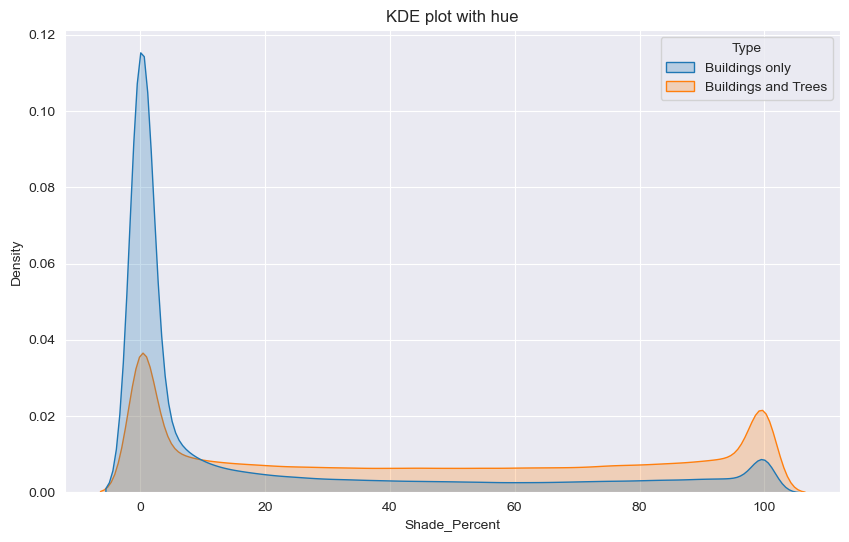

In [44]:
plt.figure(figsize=(10, 6))
sns.kdeplot(data=plot_df_filtered, x="Shade_Percent", hue="Type", fill=True, common_norm=False)
plt.title("KDE plot with hue")
plt.show()

Plot saved to ../results/figures/240916_sidewalks_plot.png


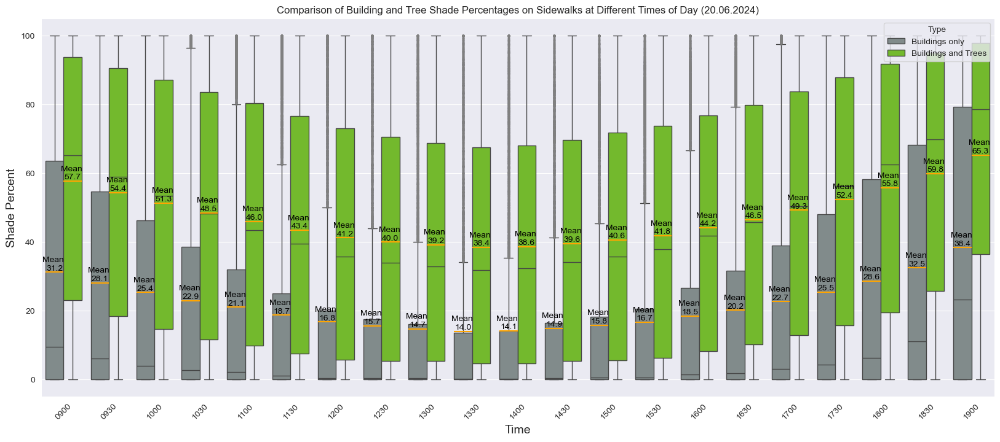

In [19]:
from datetime import datetime as dt
import os

def plot_shade_comparison(sidewalks, times, title, save_path = None):
    # Prepare the data for plotting
    plot_data = []

    for time in times:
        building_col = f'building_shade_percent_at_{time}'
        tree_col = f'tree_shade_percent_at_{time}'

        df_temp = pd.DataFrame({
            'Shade_Percent': sidewalks[[building_col, tree_col]].stack(),
            'Type': sidewalks[[building_col, tree_col]].stack().index.get_level_values(1).map({
                building_col: 'Buildings only',
                tree_col: 'Buildings and Trees'
            }),
            'Time': time
        })

        plot_data.append(df_temp)

    # Concatenate all dataframes
    plot_df_filtered = pd.concat(plot_data, axis=0)

    # Plotting
    plt.figure(figsize=(20, 8))

    # Reuse the custom palette from the first plot
    palette = {'Buildings only': '#7f8c8d', 'Buildings and Trees': '#73d016'}  # Grey and Green

    meanlineprops = dict(linestyle='-', linewidth=1.5, color='orange')

    ax = sns.boxplot(x='Time', y='Shade_Percent', hue='Type', data=plot_df_filtered, palette=palette, fliersize=1.5,  # Reduce the size of outliers
        flierprops={"marker": "o", "markerfacecolor": "none", "alpha": 0.1, "markeredgecolor":"gray"}, meanline=True, showmeans=True,
                meanprops=meanlineprops)  # Customize outliers)

    # Calculate means and annotate
    means = plot_df_filtered.groupby(['Time', 'Type'])['Shade_Percent'].mean().reset_index()

    # Get the positions of the boxes to properly place the labels
    positions = np.array(range(len(times)))  # Positions on the x-axis for each time point
    offsets = [-0.2, 0.2]  # Offsets for 'Building' and 'Tree' boxes

    for i, row in means.iterrows():
        time_position = positions[times.index(row['Time'])]  # Position on the x-axis
        offset = offsets[0] if row['Type'] == 'Buildings only' else offsets[1]
        plt.text(x=time_position + offset, 
                 y=row['Shade_Percent'] + 0.5,  # Add a small offset to position the label above the mean point
                 s=f'Mean \n{row["Shade_Percent"]:.1f}',  # Format the mean value
                 color='black', 
                 ha='center')

    plt.legend(title='Type', frameon=True, loc='upper right')
    plt.title(title)
    plt.xticks(rotation=45)
    plt.xlabel('Time', fontsize=14)
    plt.ylabel('Shade Percent', fontsize=14)

    # Save the plot if a save_path is provided
    if save_path:
        # Get the current date
        current_date = dt.now().strftime('%-y%m%d')
        # Get the name of the input DataFrame
        df_name = [name for name in globals() if globals()[name] is sidewalks][0]
        # Create the full save path with the current date and dataframe name
        filename = f"{current_date}_{df_name}_plot.png"
        full_save_path = os.path.join(save_path, filename)
        
        # Ensure the directory exists
        os.makedirs(os.path.dirname(full_save_path), exist_ok=True)
        plt.savefig(full_save_path)
        print(f"Plot saved to {full_save_path}")

    plt.show()

# Example usage:
times = [
    '0900', '0930', '1000', '1030', '1100', '1130',
    '1200', '1230', '1300', '1330', '1400', '1430',
    '1500', '1530', '1600', '1630', '1700', '1730',
    '1800', '1830', '1900'
]
plot_shade_comparison(sidewalks, times, 'Comparison of Building and Tree Shade Percentages on Sidewalks at Different Times of Day (20.06.2024)', save_path = '../results/figures/')

Plot saved to ../results/figures/240916_gdf_cleaned_plot.png


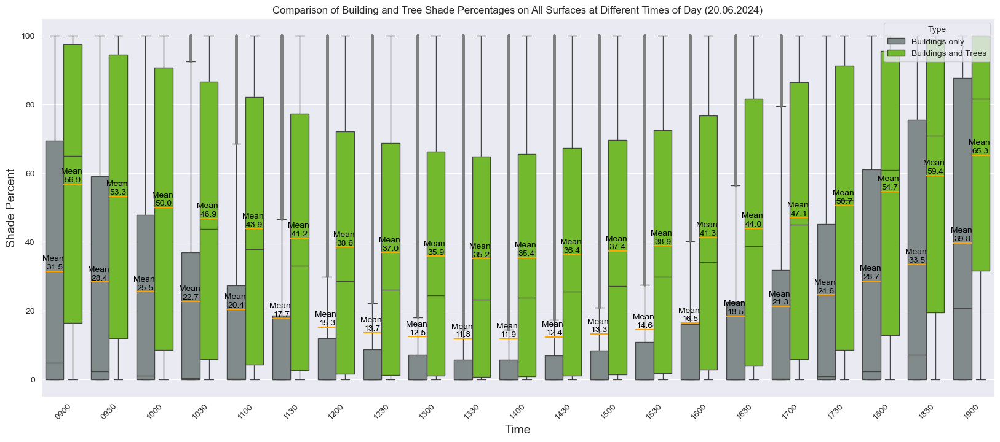

In [23]:
plot_shade_comparison(gdf_cleaned, times, 'Comparison of Building and Tree Shade Percentages on All Surfaces at Different Times of Day (20.06.2024)', save_path = '../results/figures/')

Plot saved to ../results/figures/240916_cycling_plot.png


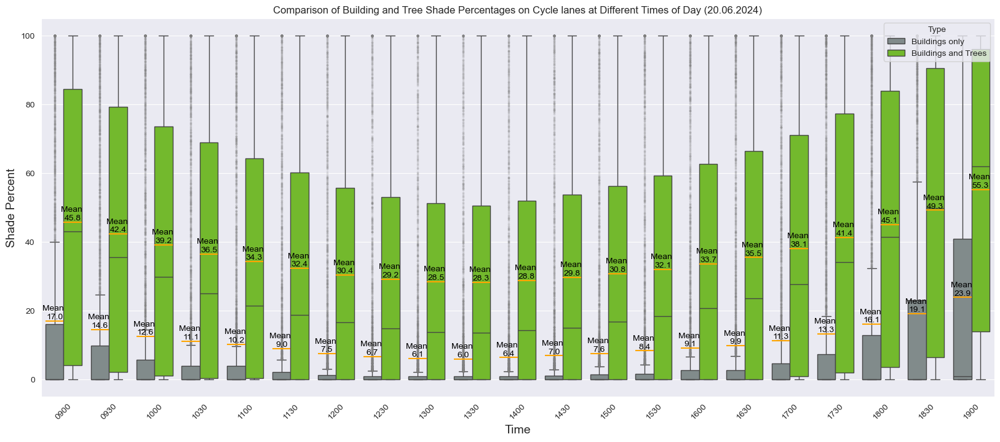

In [22]:
plot_shade_comparison(cycling, times, 'Comparison of Building and Tree Shade Percentages on Cycle lanes at Different Times of Day (20.06.2024)', save_path = '../results/figures/')

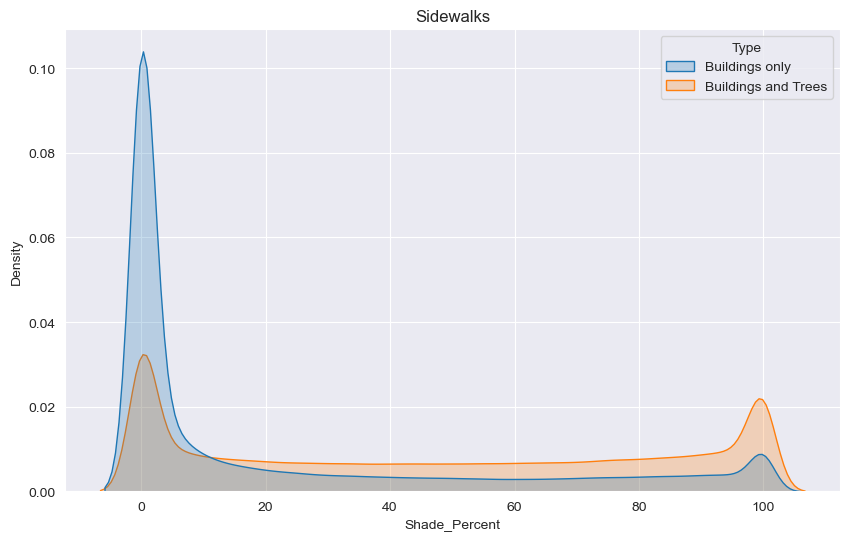

In [68]:
def kde_plot(df, times, title, save_path=None):
    # Prepare the data for plotting
    plot_data = []

    for time in times:
        building_col = f'building_shade_percent_at_{time}'
        tree_col = f'tree_shade_percent_at_{time}'

        df_temp = pd.DataFrame({
            'Shade_Percent': df[[building_col, tree_col]].stack(),
            'Type': df[[building_col, tree_col]].stack().index.get_level_values(1).map({
                building_col: 'Buildings only',
                tree_col: 'Buildings and Trees'
            }),
            'Time': time
        })

        plot_data.append(df_temp)

    # Concatenate all dataframes
    plot_df_filtered = pd.concat(plot_data, axis=0)

    plt.figure(figsize=(10, 6))
    sns.kdeplot(plot_df_filtered, x="Shade_Percent", hue="Type", fill=True, common_norm=False)
    plt.title(title)
    plt.show()

times = [
    '0900', '0930', '1000', '1030', '1100', '1130',
    '1200', '1230', '1300', '1330', '1400', '1430',
    '1500', '1530', '1600', '1630', '1700', '1730',
    '1800', '1830', '1900'
]
kde_plot(sidewalks, times, 'Sidewalks')




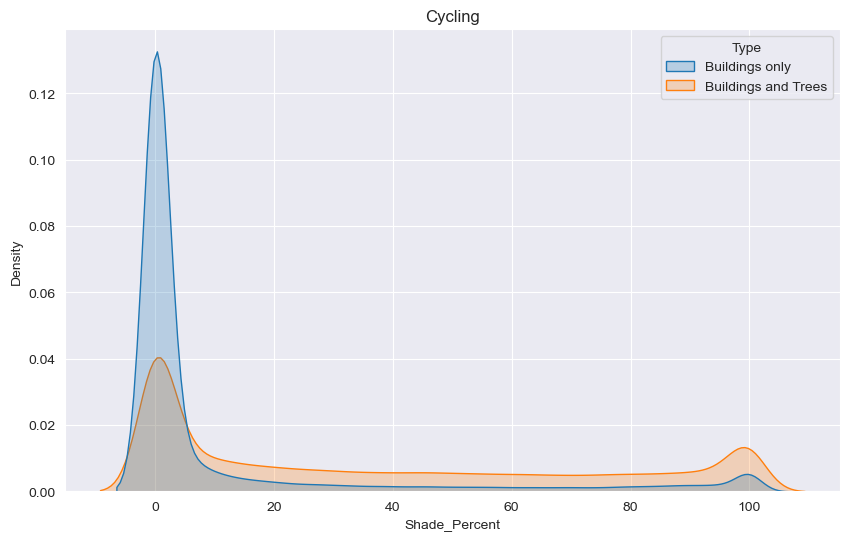

In [69]:
times = [
    '0900', '0930', '1000', '1030', '1100', '1130',
    '1200', '1230', '1300', '1330', '1400', '1430',
    '1500', '1530', '1600', '1630', '1700', '1730',
    '1800', '1830', '1900'
]
kde_plot(cycling, times, 'Cycling')

### Calculate bearing and cardinal orientation

In [86]:
import numpy as np
import geopandas as gpd
from shapely.geometry import Polygon

def calculate_bearing(pointA, pointB):
    """Calculate the bearing between two points."""
    lat1 = np.radians(pointA[1])
    lat2 = np.radians(pointB[1])
    diffLong = np.radians(pointB[0] - pointA[0])

    x = np.sin(diffLong) * np.cos(lat2)
    y = np.cos(lat1) * np.sin(lat2) - (np.sin(lat1) * np.cos(lat2) * np.cos(diffLong))

    initial_bearing = np.arctan2(x, y)
    initial_bearing = np.degrees(initial_bearing)
    compass_bearing = (initial_bearing + 360) % 360
    
    return compass_bearing

def bearing_to_cardinal(bearing):
    """Convert bearing to cardinal direction."""
    cardinals = ['N', 'NE', 'E', 'SE', 'S', 'SW', 'W', 'NW']
    idx = round(bearing / 45) % 8
    return cardinals[idx]

def get_side_orientations(polygon):
    """Identify the cardinal orientation of the longest and shortest sides of a polygon."""
    coords = list(polygon.exterior.coords)
    
    bearings = []
    lengths = []
    
    for i in range(len(coords) - 1):
        pointA = coords[i]
        pointB = coords[i + 1]
        
        length = np.linalg.norm(np.array(pointB) - np.array(pointA))
        bearing = calculate_bearing(pointA, pointB)
        
        bearings.append(bearing)
        lengths.append(length)
    
    longest_idx = np.argmax(lengths)
    shortest_idx = np.argmin(lengths)
    print(longest_idx)
    print(shortest_idx)

    longest_orientation = bearing_to_cardinal(bearings[longest_idx])
    shortest_orientation = bearing_to_cardinal(bearings[shortest_idx])
    
    return longest_orientation, shortest_orientation

# Example usage with a GeoSeries
gdf = gpd.GeoSeries([
    Polygon([(0, 0), (4, 0), (4, 3), (0, 3), (0, 0)]),
    Polygon([(1, 1), (5, 1), (5, 4), (1, 4), (1, 1)])
])

orientations = sidewalks[0:10].geometry.apply(get_side_orientations)
print(orientations)

3
0
3
0
9
6
3
4
27
0
0
1
0
1
18
27
4
1
0
30
152      (N, S)
152      (N, S)
204      (S, N)
283      (N, W)
480      (E, N)
484      (W, S)
730    (NW, SW)
799     (SW, E)
808      (N, S)
824    (NW, SW)
Name: geometry, dtype: object


<Axes: >

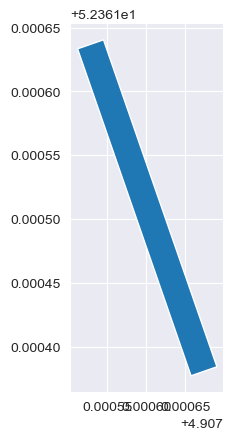

In [92]:
sidewalks[3:4].plot()

In [76]:
sidewalks[0:1].exterior

152    LINEARRING (4.85564 52.37438, 4.85565 52.37437...
dtype: geometry

In [73]:
sidewalks[0:1].geometry

152    POLYGON ((4.85564 52.37438, 4.85565 52.37437, ...
Name: geometry, dtype: geometry

In [ ]:
### Group by Buurten

In [144]:
grouped_buurten = filtered_gdf.groupby('Buurtcode')['diff_20240620_building_mean_vs_20240620_tree_mean'].mean()
grouped_buurten

# Convert the Series to a DataFrame for merging
grouped_buurten_df = grouped_buurten.reset_index()
grouped_buurten_df.rename(columns={'diff_20240620_building_mean_vs_20240620_tree_mean': 'mean_diff'}, inplace=True)

print(grouped_buurten_df.head())

  Buurtcode  mean_diff
0      AA01   0.166755
1      AA02   0.175221
2      AA03   0.114335
3      AA04   0.186829
4      AA05   0.122327


### expanding the aggregation function to include more general columns: 

In [145]:

# Perform the grouping and include additional columns
grouped_buurten = filtered_gdf.groupby('Buurtcode').agg(
    mean_diff=('diff_20240620_building_mean_vs_20240620_tree_mean', 'mean'),
    sum_diff=('diff_20240620_building_mean_vs_20240620_tree_mean', 'sum'),
    count_diff=('diff_20240620_building_mean_vs_20240620_tree_mean', 'count'),
    median_diff=('diff_20240620_building_mean_vs_20240620_tree_mean', 'median'),
    day_building_mean=('20240620_building_mean', 'mean'),
    day_building_std=('20240620_building_std', 'mean'),
    day_mean=('20240620_tree_mean', 'mean'),
    day_std=('20240620_tree_std', 'mean'),
    lunch_mean_shade_perc=('tree_shade_percent_at_1200', 'mean'),
    closing_mean_shade_perc=('tree_shade_percent_at_1600', 'mean')
    # Add more columns and aggregation functions as needed
)

# Convert the resulting DataFrame for merging if necessary
grouped_buurten_df = grouped_buurten.reset_index()

# Now grouped_buurten_df contains the additional columns
print(grouped_buurten_df)

    Buurtcode  mean_diff   sum_diff  count_diff  median_diff  \
0        AA01   0.166755   5.502929          33     0.134943   
1        AA02   0.175221  39.424770         225     0.141208   
2        AA03   0.114335  14.177551         124     0.077530   
3        AA04   0.186829   3.176093          17     0.184197   
4        AA05   0.122327  19.327607         158     0.103797   
..        ...        ...        ...         ...          ...   
455      TL02   0.318595   7.646284          24     0.204221   
456      TL03   0.220182  55.926163         254     0.183896   
457      TL04   0.164584  28.143833         171     0.136277   
458      TM01   0.307384  67.009795         218     0.270308   
459      TM03   0.189732  52.935363         279     0.143670   

     day_building_mean  day_building_std  day_mean   day_std  \
0             0.446465          0.096938  0.613220  0.128104   
1             0.501664          0.123927  0.676885  0.130737   
2             0.422835          0.09232

In [146]:
# Assuming `additional_gdf` is your GeoDataFrame with the 'Buurtcode' column
# Load your GeoDataFrame with 'Buurtcode'
# additional_gdf = gpd.read_file('path_to_additional_geodatafile')

# Merge the grouped results with the GeoDataFrame on 'Buurtcode'
buurten_with_stats = buurten.merge(grouped_buurten_df, on='Buurtcode', how='left')

# Display the resulting GeoDataFrame
print(buurten_with_stats.head())

  CBS_Buurtcode Buurtcode               Buurt Wijkcode  \
0    BU0363AC02      AC02    Leliegracht e.o.       AC   
1    BU0363AC03      AC03  Felix Meritisbuurt       AC   
2    BU0363AC04      AC04  Leidsegracht-Noord       AC   
3    BU0363AD01      AD01  Stationsplein e.o.       AD   
4    BU0363AD02      AD02           Hemelrijk       AD   

                      Wijk Gebiedcode        Gebied Stadsdeelcode Stadsdeel  \
0      Grachtengordel-West       GA01  Centrum-West             A   Centrum   
1      Grachtengordel-West       GA01  Centrum-West             A   Centrum   
2      Grachtengordel-West       GA01  Centrum-West             A   Centrum   
3  Burgwallen-Nieuwe Zijde       GA01  Centrum-West             A   Centrum   
4  Burgwallen-Nieuwe Zijde       GA01  Centrum-West             A   Centrum   

   Oppervlakte_m2  ... mean_diff   sum_diff  count_diff  median_diff  \
0          172784  ...  0.164753  23.559741       143.0     0.140294   
1          202396  ...  0.178693

In [147]:
buurten_with_stats.head()

,CBS_Buurtcode,Buurtcode,Buurt,Wijkcode,Wijk,Gebiedcode,Gebied,Stadsdeelcode,Stadsdeel,Oppervlakte_m2,...,mean_diff,sum_diff,count_diff,median_diff,day_building_mean,day_building_std,day_mean,day_std,lunch_mean_shade_perc,closing_mean_shade_perc
0,BU0363AC02,AC02,Leliegracht e.o.,AC,Grachtengordel-West,GA01,Centrum-West,A,Centrum,172784,...,0.164753,23.559741,143.0,0.140294,0.533417,0.086477,0.698171,0.112682,55.109013,54.182009
1,BU0363AC03,AC03,Felix Meritisbuurt,AC,Grachtengordel-West,GA01,Centrum-West,A,Centrum,202396,...,0.178693,30.377874,170.0,0.167856,0.566387,0.083081,0.745081,0.109673,64.221784,65.292554
2,BU0363AC04,AC04,Leidsegracht-Noord,AC,Grachtengordel-West,GA01,Centrum-West,A,Centrum,68876,...,0.209341,15.491233,74.0,0.191808,0.516615,0.074474,0.725956,0.096689,62.489631,55.896278
3,BU0363AD01,AD01,Stationsplein e.o.,AD,Burgwallen-Nieuwe Zijde,GA01,Centrum-West,A,Centrum,259429,...,0.135581,10.168552,75.0,0.069521,0.249693,0.084655,0.385274,0.114841,21.961009,27.662388
4,BU0363AD02,AD02,Hemelrijk,AD,Burgwallen-Nieuwe Zijde,GA01,Centrum-West,A,Centrum,62725,...,0.102361,9.212528,90.0,0.063499,0.527564,0.114619,0.629926,0.129009,44.764995,42.908681


In [168]:
buurten_with_stats.explore(column='day_building_mean', cmap='RdYlBu', tiles= 'CartoDB positron')

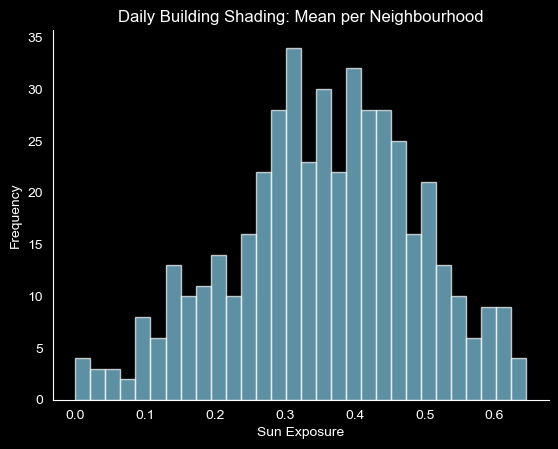

In [148]:
# Create a histogram with transparency and style it for a black background
plt.style.use('dark_background')

ax = buurten_with_stats.hist(
    column='day_building_mean', 
    bins=30, 
    edgecolor='white', 
    color='skyblue', 
    alpha=0.7, 
    grid=False
)

# Customize the plot further
for a in ax.flatten():
    a.set_xlabel('Sun Exposure')
    a.set_ylabel('Frequency')
    a.set_title('Daily Building Shading: Mean per Neighbourhood')
    a.spines['top'].set_visible(False)
    a.spines['right'].set_visible(False)
    a.spines['left'].set_color('white')
    a.spines['bottom'].set_color('white')
    a.tick_params(axis='x', colors='white')
    a.tick_params(axis='y', colors='white')

# Show the plot
plt.show()

In [169]:
buurten_with_stats.explore(column='day_mean', cmap='RdYlBu', tiles= 'CartoDB positron')

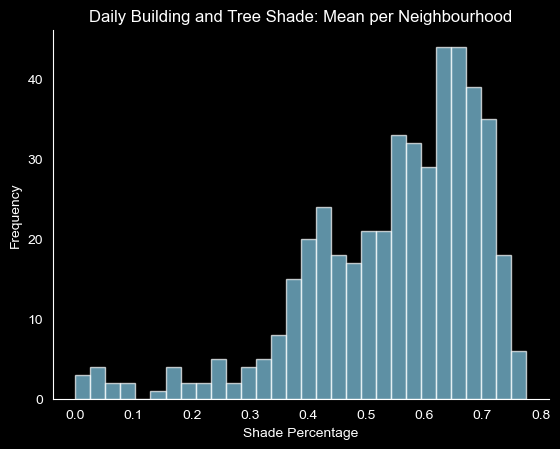

In [170]:
# Create a histogram with transparency and style it for a black background
plt.style.use('dark_background')

ax = buurten_with_stats.hist(
    column='day_mean', 
    bins=30, 
    edgecolor='white', 
    color='skyblue', 
    alpha=0.7, 
    grid=False
)

# Customize the plot further
for a in ax.flatten():
    a.set_xlabel('Shade Percentage')
    a.set_ylabel('Frequency')
    a.set_title('Daily Building and Tree Shade: Mean per Neighbourhood')
    a.spines['top'].set_visible(False)
    a.spines['right'].set_visible(False)
    a.spines['left'].set_color('white')
    a.spines['bottom'].set_color('white')
    a.tick_params(axis='x', colors='white')
    a.tick_params(axis='y', colors='white')

# Show the plot
plt.show()

In [171]:
buurten_with_stats.explore(column='day_std', cmap='viridis', tiles= 'CartoDB positron')

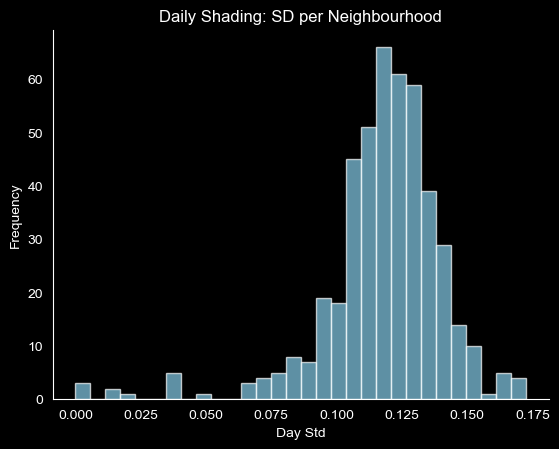

In [172]:
# Create a histogram with transparency and style it for a black background
plt.style.use('dark_background')

ax = buurten_with_stats.hist(
    column='day_std', 
    bins=30, 
    edgecolor='white', 
    color='skyblue', 
    alpha=0.7, 
    grid=False
)

# Customize the plot further
for a in ax.flatten():
    a.set_xlabel('Day Std')
    a.set_ylabel('Frequency')
    a.set_title('Daily Shading: SD per Neighbourhood')
    a.spines['top'].set_visible(False)
    a.spines['right'].set_visible(False)
    a.spines['left'].set_color('white')
    a.spines['bottom'].set_color('white')
    a.tick_params(axis='x', colors='white')
    a.tick_params(axis='y', colors='white')

# Show the plot
plt.show()

In [173]:
buurten_with_stats.explore(column='lunch_mean_shade_perc', cmap='RdYlBu', tiles= 'CartoDB positron')



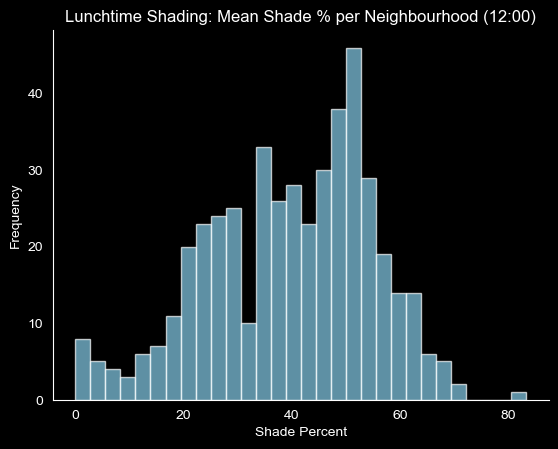

In [174]:
# Create a histogram with transparency and style it for a black background
plt.style.use('dark_background')

ax = buurten_with_stats.hist(
    column='lunch_mean_shade_perc', 
    bins=30, 
    edgecolor='white', 
    color='skyblue', 
    alpha=0.7, 
    grid=False
)

# Customize the plot further
for a in ax.flatten():
    a.set_xlabel('Shade Percent')
    a.set_ylabel('Frequency')
    a.set_title('Lunchtime Shading: Mean Shade % per Neighbourhood (12:00)')
    a.spines['top'].set_visible(False)
    a.spines['right'].set_visible(False)
    a.spines['left'].set_color('white')
    a.spines['bottom'].set_color('white')
    a.tick_params(axis='x', colors='white')
    a.tick_params(axis='y', colors='white')

# Show the plot
plt.show()

In [175]:
buurten_with_stats.explore(column='closing_mean_shade_perc', cmap='GnBu_r', tiles= 'CartoDB positron')

In [177]:
buurten_with_stats['mean_diff'] = buurten_with_stats['mean_diff'].abs()


In [180]:
buurten_with_stats.explore(column='mean_diff', cmap='RdYlBu_r', tiles= 'CartoDB positron')

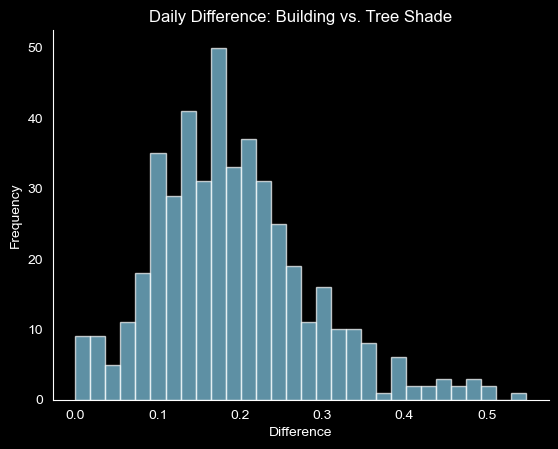

In [179]:
# Create a histogram with transparency and style it for a black background
plt.style.use('dark_background')

ax = buurten_with_stats.hist(
    column='mean_diff', 
    bins=30, 
    edgecolor='white', 
    color='skyblue', 
    alpha=0.7, 
    grid=False
)

# Customize the plot further
for a in ax.flatten():
    a.set_xlabel('Difference')
    a.set_ylabel('Frequency')
    a.set_title('Daily Difference: Building vs. Tree Shade')
    a.spines['top'].set_visible(False)
    a.spines['right'].set_visible(False)
    a.spines['left'].set_color('white')
    a.spines['bottom'].set_color('white')
    a.tick_params(axis='x', colors='white')
    a.tick_params(axis='y', colors='white')

# Show the plot
plt.show()

In [ ]:
# Group by 'Buurtcode' and 'Gebruiksfunctie' and compute the mean
grouped_df = filtered_gdf.groupby(['Buurtcode', 'Gebruiksfunctie'])['diff_20240620_building_mean_vs_20240620_tree_mean'].mean().reset_index()
grouped_df.rename(columns={'diff_20240620_building_mean_vs_20240620_tree_mean': 'mean_diff'}, inplace=True)

In [ ]:
# Pivot the DataFrame to get 'Gebruiksfunctie' values as columns
pivoted_df = grouped_df.pivot_table(index='Buurtcode', columns='Gebruiksfunctie', values='mean_diff').reset_index()

# Optional: Rename columns for better readability, if needed
pivoted_df.columns.name = None  # Remove the name of the columns index

In [ ]:
pivoted_df.head()

In [47]:
# Assuming `additional_gdf` is your GeoDataFrame with the 'Buurtcode' column
# Load your GeoDataFrame with 'Buurtcode'
# additional_gdf = gpd.read_file('path_to_additional_geodatafile')

# Merge the grouped results with the GeoDataFrame on 'Buurtcode'
buurten_with_stats_new = buurten.merge(pivoted_df, on='Buurtcode', how='left')

# Display the resulting GeoDataFrame
buurten_with_stats_new.head()

,CBS_Buurtcode,Buurtcode,Buurt,Wijkcode,Wijk,Gebiedcode,Gebied,Stadsdeelcode,Stadsdeel,Oppervlakte_m2,geometry,Fietspad,Voetgangersgebied,Voetpad,Voetpad op trap
0,BU0363AC02,AC02,Leliegracht e.o.,AC,Grachtengordel-West,GA01,Centrum-West,A,Centrum,172784,"POLYGON ((4.88307 52.37399, 4.88338 52.37407, ...",-0.185861,NaN,-0.164301,NaN
1,BU0363AC03,AC03,Felix Meritisbuurt,AC,Grachtengordel-West,GA01,Centrum-West,A,Centrum,202396,"POLYGON ((4.88261 52.36893, 4.88441 52.36886, ...",NaN,NaN,-0.178693,NaN
2,BU0363AC04,AC04,Leidsegracht-Noord,AC,Grachtengordel-West,GA01,Centrum-West,A,Centrum,68876,"POLYGON ((4.88260 52.36876, 4.88242 52.36674, ...",NaN,NaN,-0.206387,-0.425000
3,BU0363AD01,AD01,Stationsplein e.o.,AD,Burgwallen-Nieuwe Zijde,GA01,Centrum-West,A,Centrum,259429,"POLYGON ((4.89547 52.37986, 4.89753 52.37876, ...",-0.119065,-0.132768,-0.138979,-0.370652
4,BU0363AD02,AD02,Hemelrijk,AD,Burgwallen-Nieuwe Zijde,GA01,Centrum-West,A,Centrum,62725,"POLYGON ((4.89208 52.37703, 4.89420 52.37661, ...",-0.141378,NaN,-0.107807,-0.023625


In [57]:
buurten_with_stats_new.explore(column='Voetpad', cmap='RdYlGn_r', tiles= 'CartoDB positron')

In [115]:
buurten_with_stats

,CBS_Buurtcode,Buurtcode,Buurt,Wijkcode,Wijk,Gebiedcode,Gebied,Stadsdeelcode,Stadsdeel,Oppervlakte_m2,...,mean_diff,sum_diff,count_diff,median_diff,day_building_mean,day_building_std,day_mean,day_std,lunch_mean_shade_perc,closing_mean_shade_perc
0,BU0363AC02,AC02,Leliegracht e.o.,AC,Grachtengordel-West,GA01,Centrum-West,A,Centrum,172784,...,0.164753,-23.559741,143.0,-0.140294,0.466583,0.086477,0.301829,0.112682,55.109013,54.182009
1,BU0363AC03,AC03,Felix Meritisbuurt,AC,Grachtengordel-West,GA01,Centrum-West,A,Centrum,202396,...,0.178693,-30.377874,170.0,-0.167856,0.433613,0.083081,0.254919,0.109673,64.221784,65.292554
2,BU0363AC04,AC04,Leidsegracht-Noord,AC,Grachtengordel-West,GA01,Centrum-West,A,Centrum,68876,...,0.209341,-15.491233,74.0,-0.191808,0.483385,0.074474,0.274044,0.096689,62.489631,55.896278
3,BU0363AD01,AD01,Stationsplein e.o.,AD,Burgwallen-Nieuwe Zijde,GA01,Centrum-West,A,Centrum,259429,...,0.135581,-10.168552,75.0,-0.069521,0.750307,0.084655,0.614726,0.114841,21.961009,27.662388
4,BU0363AD02,AD02,Hemelrijk,AD,Burgwallen-Nieuwe Zijde,GA01,Centrum-West,A,Centrum,62725,...,0.102361,-9.212528,90.0,-0.063499,0.472436,0.114619,0.370074,0.129009,44.764995,42.908681
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
513,BU0363AB08,AB08,Groenmarktkadebuurt,AB,Jordaan,GA01,Centrum-West,A,Centrum,49285,...,0.245385,-13.250781,54.0,-0.214158,0.571347,0.119203,0.325962,0.123150,52.253374,58.051896
514,BU0363AB09,AB09,Marnixbuurt-Zuid,AB,Jordaan,GA01,Centrum-West,A,Centrum,51032,...,0.214942,-11.391909,53.0,-0.222685,0.496552,0.109867,0.281610,0.115440,54.933338,63.379491
515,BU0363AB10,AB10,Elandsgrachtbuurt,AB,Jordaan,GA01,Centrum-West,A,Centrum,207114,...,0.126857,-30.699498,242.0,-0.083482,0.405180,0.115428,0.278323,0.121409,61.548088,56.914978
516,BU0363AB11,AB11,Passeerdersgrachtbuurt,AB,Jordaan,GA01,Centrum-West,A,Centrum,54476,...,0.125866,-9.062318,72.0,-0.090984,0.434545,0.091379,0.308680,0.113958,55.274405,51.230073


In [119]:
sample = buurten_with_stats.sample(2)
sample_2 = buurten_with_stats[0:4]
sample

,CBS_Buurtcode,Buurtcode,Buurt,Wijkcode,Wijk,Gebiedcode,Gebied,Stadsdeelcode,Stadsdeel,Oppervlakte_m2,...,mean_diff,sum_diff,count_diff,median_diff,day_building_mean,day_building_std,day_mean,day_std,lunch_mean_shade_perc,closing_mean_shade_perc
286,BU0363SD03,SD03,Weesp Centrum,SD,Weesp Binnenstad/Zuid,GS25,"Weesp, Driemond",S,Weesp,420950,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
129,BU0363MN07,MN07,Sportpark Middenmeer-Noord,MN,Middenmeer,GM16,Watergraafsmeer,M,Oost,250051,...,0.354647,-36.528688,103.0,-0.357273,0.80913,0.083629,0.454482,0.126215,42.269555,40.930829


In [120]:
sample_2

,CBS_Buurtcode,Buurtcode,Buurt,Wijkcode,Wijk,Gebiedcode,Gebied,Stadsdeelcode,Stadsdeel,Oppervlakte_m2,...,mean_diff,sum_diff,count_diff,median_diff,day_building_mean,day_building_std,day_mean,day_std,lunch_mean_shade_perc,closing_mean_shade_perc
0,BU0363AC02,AC02,Leliegracht e.o.,AC,Grachtengordel-West,GA01,Centrum-West,A,Centrum,172784,...,0.164753,-23.559741,143.0,-0.140294,0.466583,0.086477,0.301829,0.112682,55.109013,54.182009
1,BU0363AC03,AC03,Felix Meritisbuurt,AC,Grachtengordel-West,GA01,Centrum-West,A,Centrum,202396,...,0.178693,-30.377874,170.0,-0.167856,0.433613,0.083081,0.254919,0.109673,64.221784,65.292554
2,BU0363AC04,AC04,Leidsegracht-Noord,AC,Grachtengordel-West,GA01,Centrum-West,A,Centrum,68876,...,0.209341,-15.491233,74.0,-0.191808,0.483385,0.074474,0.274044,0.096689,62.489631,55.896278
3,BU0363AD01,AD01,Stationsplein e.o.,AD,Burgwallen-Nieuwe Zijde,GA01,Centrum-West,A,Centrum,259429,...,0.135581,-10.168552,75.0,-0.069521,0.750307,0.084655,0.614726,0.114841,21.961009,27.662388


In [114]:
import pandas as pd

# Group by 'Gebruiksfunktie' and calculate mean for before and after
grouped_before = filtered_gdf.groupby('Gebruiksfunctie')[before_cols].mean()
grouped_after = filtered_gdf.groupby('Gebruiksfunctie')[after_cols].mean()

grouped_mean = filtered_gdf.groupby('Gebruiksfunctie')[before_cols + after_cols].mean()

# Calculate pairwise differences
for before_col, after_col in zip(before_cols, after_cols):
    diff_col_name = f'diff_{before_col}_vs_{after_col}'
    grouped_mean[diff_col_name] = grouped_mean[after_col] - grouped_mean[before_col]


grouped_mean
# # Calculate differences
# differences = grouped_after - grouped_before

# differences

,20240620_building_mean,20240620_building_std,20240620_building_min,20240620_building_max,building_shade_percent_at_1200,building_shade_percent_at_1500,building_shade_percent_at_1600,20240620_tree_mean,20240620_tree_std,20240620_tree_min,...,tree_shade_percent_at_1200,tree_shade_percent_at_1500,tree_shade_percent_at_1600,diff_20240620_building_mean_vs_20240620_tree_mean,diff_20240620_building_std_vs_20240620_tree_std,diff_20240620_building_min_vs_20240620_tree_min,diff_20240620_building_max_vs_20240620_tree_max,diff_building_shade_percent_at_1200_vs_tree_shade_percent_at_1200,diff_building_shade_percent_at_1500_vs_tree_shade_percent_at_1500,diff_building_shade_percent_at_1600_vs_tree_shade_percent_at_1600
Gebruiksfunctie,,,,,,,,,,,,,,,,,,,,,
Fietspad,0.733192,0.062769,0.531766,0.838483,7.542638,7.620454,9.133740,0.522400,0.104490,0.27888,...,30.404405,30.789139,33.653362,-0.210791,0.041721,-0.252885,-0.120393,22.861767,23.168685,24.519622
Voetpad,0.620261,0.095810,0.366186,0.834586,17.236681,16.226347,18.974032,0.427246,0.123658,0.17516,...,41.433009,40.866869,44.424105,-0.193014,0.027848,-0.191027,-0.122233,24.196328,24.640522,25.450074


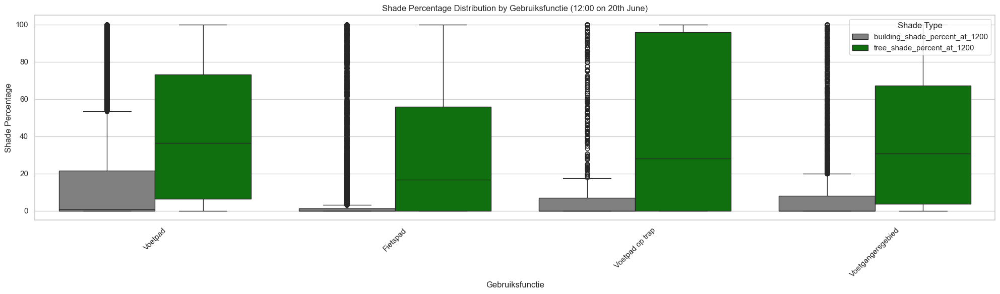

In [20]:

# Assuming gdf is your dataframe
# Melt the dataframe
melted_hourly = filtered_gdf.melt(id_vars=['Gebruiksfunctie','Buurtcode'], 
                      value_vars=['building_shade_percent_at_1200', 'tree_shade_percent_at_1200'], 
                      var_name='Shade_Type', 
                      value_name='Shade_Percentage')

# Set up the visualizations
sns.set(style="whitegrid")

# Define a custom color palette
custom_palette = {'building_shade_percent_at_1200': 'grey', 'tree_shade_percent_at_1200': 'green'}

# Box plot
plt.figure(figsize=(20, 6))
sns.boxplot(x='Gebruiksfunctie', y='Shade_Percentage', hue='Shade_Type', data=melted_hourly, palette=custom_palette)
plt.title('Shade Percentage Distribution by Gebruiksfunctie (12:00 on 20th June)')
plt.xlabel('Gebruiksfunctie')
plt.ylabel('Shade Percentage')
plt.xticks(rotation=45)
plt.legend(title='Shade Type', loc='upper right')
plt.tight_layout()
plt.show()

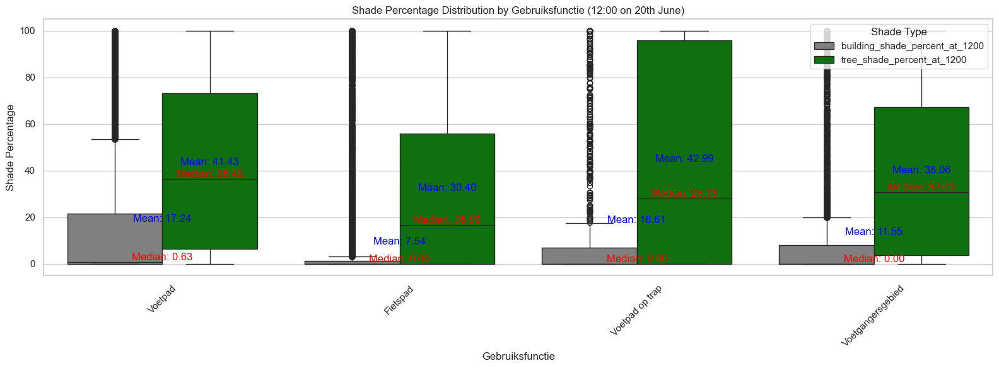

In [42]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Assuming filtered_gdf is already defined and loaded

# Melt the dataframe
melted_hourly = filtered_gdf.melt(id_vars=['Gebruiksfunctie', 'Buurtcode'], 
                      value_vars=['building_shade_percent_at_1200', 'tree_shade_percent_at_1200'], 
                      var_name='Shade_Type', 
                      value_name='Shade_Percentage')

# Set up the visualizations
sns.set(style="whitegrid")

# Define a custom color palette
custom_palette = {'building_shade_percent_at_1200': 'grey', 'tree_shade_percent_at_1200': 'green'}

# Box plot
plt.figure(figsize=(16, 6))
ax = sns.boxplot(x='Gebruiksfunctie', y='Shade_Percentage', hue='Shade_Type', data=melted_hourly, palette=custom_palette)

# Calculate mean and median for annotation
stats = melted_hourly.groupby(['Gebruiksfunctie', 'Shade_Type'])['Shade_Percentage'].agg(['mean', 'median']).reset_index()

# Add annotations for mean and median
for _, row in stats.iterrows():
    # Filter for each box plot element
    subset = melted_hourly[(melted_hourly['Gebruiksfunctie'] == row['Gebruiksfunctie']) & (melted_hourly['Shade_Type'] == row['Shade_Type'])]
    
    # Get the position of the boxplot for this group
    x_pos = melted_hourly['Gebruiksfunctie'].unique().tolist().index(row['Gebruiksfunctie'])
    hue_pos = melted_hourly['Shade_Type'].unique().tolist().index(row['Shade_Type'])
    
    # Label positions
    y_mean = row['mean']
    y_median = row['median']

    # Add text annotations
    ax.text(x_pos + hue_pos * 0.2, y_mean, f'Mean: {y_mean:.2f}', color='blue', ha='center', va='bottom')
    ax.text(x_pos + hue_pos * 0.2, y_median, f'Median: {y_median:.2f}', color='red', ha='center', va='bottom')

plt.title('Shade Percentage Distribution by Gebruiksfunctie (12:00 on 20th June)')
plt.xlabel('Gebruiksfunctie')
plt.ylabel('Shade Percentage')
plt.xticks(rotation=45)
plt.legend(title='Shade Type', loc='upper right')
plt.tight_layout()
plt.show()

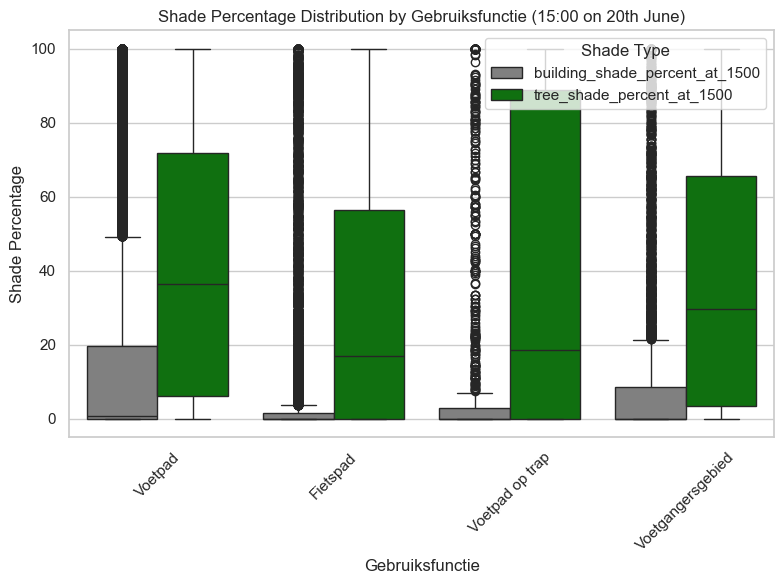

In [25]:

# Assuming gdf is your dataframe
# Melt the dataframe
melted_hourly = filtered_gdf.melt(id_vars=['Gebruiksfunctie','Buurtcode'], 
                      value_vars=['building_shade_percent_at_1500', 'tree_shade_percent_at_1500'], 
                      var_name='Shade_Type', 
                      value_name='Shade_Percentage')

# Set up the visualizations
sns.set(style="whitegrid")

# Define a custom color palette
custom_palette = {'building_shade_percent_at_1500': 'grey', 'tree_shade_percent_at_1500': 'green'}

# Box plot
plt.figure(figsize=(8, 6))
sns.boxplot(x='Gebruiksfunctie', y='Shade_Percentage', hue='Shade_Type', data=melted_hourly, palette=custom_palette)
plt.title('Shade Percentage Distribution by Gebruiksfunctie (15:00 on 20th June)')
plt.xlabel('Gebruiksfunctie')
plt.ylabel('Shade Percentage')
plt.xticks(rotation=45)
plt.legend(title='Shade Type', loc='upper right')
plt.tight_layout()
plt.show()

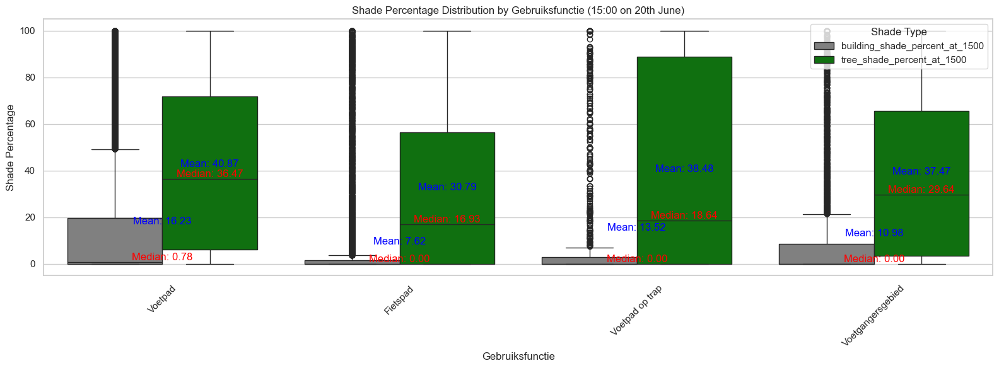

In [36]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Assuming filtered_gdf is already defined and loaded

# Melt the dataframe
melted_hourly = filtered_gdf.melt(id_vars=['Gebruiksfunctie', 'Buurtcode'], 
                      value_vars=['building_shade_percent_at_1500', 'tree_shade_percent_at_1500'], 
                      var_name='Shade_Type', 
                      value_name='Shade_Percentage')

# Set up the visualizations
sns.set(style="whitegrid")

# Define a custom color palette
custom_palette = {'building_shade_percent_at_1500': 'grey', 'tree_shade_percent_at_1500': 'green'}

# Box plot
plt.figure(figsize=(16, 6))
ax = sns.boxplot(x='Gebruiksfunctie', y='Shade_Percentage', hue='Shade_Type', data=melted_hourly, palette=custom_palette)

# Calculate mean and median for annotation
stats = melted_hourly.groupby(['Gebruiksfunctie', 'Shade_Type'])['Shade_Percentage'].agg(['mean', 'median']).reset_index()

# Add annotations for mean and median
for _, row in stats.iterrows():
    # Filter for each box plot element
    subset = melted_hourly[(melted_hourly['Gebruiksfunctie'] == row['Gebruiksfunctie']) & (melted_hourly['Shade_Type'] == row['Shade_Type'])]
    
    # Get the position of the boxplot for this group
    x_pos = melted_hourly['Gebruiksfunctie'].unique().tolist().index(row['Gebruiksfunctie'])
    hue_pos = melted_hourly['Shade_Type'].unique().tolist().index(row['Shade_Type'])
    
    # Label positions
    y_mean = row['mean']
    y_median = row['median']

    # Add text annotations
    ax.text(x_pos + hue_pos * 0.2, y_mean, f'Mean: {y_mean:.2f}', color='blue', ha='center', va='bottom')
    ax.text(x_pos + hue_pos * 0.2, y_median, f'Median: {y_median:.2f}', color='red', ha='center', va='bottom')

plt.title('Shade Percentage Distribution by Gebruiksfunctie (15:00 on 20th June)')
plt.xlabel('Gebruiksfunctie')
plt.ylabel('Shade Percentage')
plt.xticks(rotation=45)
plt.legend(title='Shade Type', loc='upper right')
plt.tight_layout()
plt.show()

In [87]:
melted_hourly

,Gebruiksfunctie,Buurtcode,Shade_Type,Shade_Percentage
0,Halte eiland,KP05,building_shade_percent_at_1200,0.0
1,Halte eiland,KR01,building_shade_percent_at_1200,0.0
2,Halte eiland,KP05,building_shade_percent_at_1200,0.0
3,Voetpad,EL01,building_shade_percent_at_1200,0.0
4,Voetpad,EE05,building_shade_percent_at_1200,0.0
...,...,...,...,...
222639,Rijbaan,MH02,tree_shade_percent_at_1200,0.0
222640,Rijbaan,MH01,tree_shade_percent_at_1200,0.0
222641,Rijbaan,MH01,tree_shade_percent_at_1200,0.0
222642,Rijbaan,MH02,tree_shade_percent_at_1200,0.0


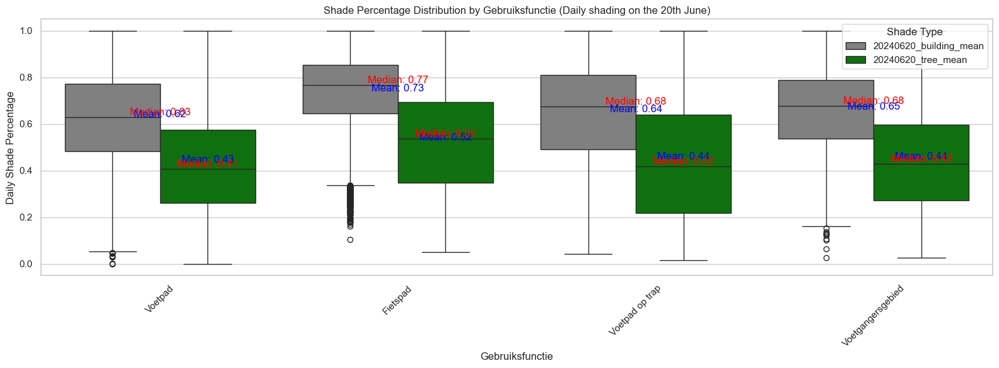

In [41]:
# Assuming gdf is your dataframe
# Melt the dataframe
melted_daily = filtered_gdf.melt(id_vars=['Gebruiksfunctie'], 
                      value_vars=['20240620_building_mean', '20240620_tree_mean'], 
                      var_name='Shade_Type', 
                      value_name='Daily_Shade_Percentage')

# Set up the visualizations
sns.set(style="whitegrid")

# Define a custom color palette
custom_palette = {'20240620_building_mean': 'grey', '20240620_tree_mean': 'green'}

# Box plot
plt.figure(figsize=(16, 6))
ax = sns.boxplot(x='Gebruiksfunctie', y='Daily_Shade_Percentage', hue='Shade_Type', data=melted_daily, palette=custom_palette)

# Calculate mean and median for annotation
stats = melted_daily.groupby(['Gebruiksfunctie', 'Shade_Type'])['Daily_Shade_Percentage'].agg(['mean', 'median']).reset_index()

# Add annotations for mean and median
for _, row in stats.iterrows():
    # Filter for each box plot element
    subset = melted_daily[(melted_daily['Gebruiksfunctie'] == row['Gebruiksfunctie']) & (melted_daily['Shade_Type'] == row['Shade_Type'])]
    
    # Get the position of the boxplot for this group
    x_pos = melted_daily['Gebruiksfunctie'].unique().tolist().index(row['Gebruiksfunctie'])
    hue_pos = melted_daily['Shade_Type'].unique().tolist().index(row['Shade_Type'])
    
    # Label positions
    y_mean = row['mean']
    y_median = row['median']

    # Add text annotations
    ax.text(x_pos + hue_pos * 0.2, y_mean, f'Mean: {y_mean:.2f}', color='blue', ha='center', va='bottom')
    ax.text(x_pos + hue_pos * 0.2, y_median, f'Median: {y_median:.2f}', color='red', ha='center', va='bottom')

# Box plot
# plt.figure(figsize=(20, 6))
# sns.boxplot(x='Gebruiksfunctie', y='Daily_Shade_Percentage', hue='Shade_Type', data=melted_daily, palette=custom_palette)
plt.title('Shade Percentage Distribution by Gebruiksfunctie (Daily shading on the 20th June)')
plt.xlabel('Gebruiksfunctie')
plt.ylabel('Daily Shade Percentage')
plt.xticks(rotation=45)
plt.legend(title='Shade Type', loc='upper right')
plt.tight_layout()
plt.show()

In [ ]:
# Assuming gdf is your dataframe
# Melt the dataframe
melted_daily = filtered_gdf.melt(id_vars=['Gebruiksfunctie'], 
                      value_vars=['20240620_building_mean', '20240620_tree_mean'], 
                      var_name='Shade_Type', 
                      value_name='Daily_Shade_Percentage')

# Set up the visualizations
sns.set(style="whitegrid")

# Define a custom color palette
custom_palette = {'20240620_building_mean': 'grey', '20240620_tree_mean': 'green'}

# Box plot
plt.figure(figsize=(20, 6))
sns.boxplot(x='Gebruiksfunctie', y='Daily_Shade_Percentage', hue='Shade_Type', data=melted_daily, palette=custom_palette)
plt.title('Shade Percentage Distribution by Gebruiksfunctie (Daily shading on the 20th June)')
plt.xlabel('Gebruiksfunctie')
plt.ylabel('Daily Shade Percentage')
plt.xticks(rotation=45)
plt.legend(title='Shade Type', loc='upper right')
plt.tight_layout()
plt.show()

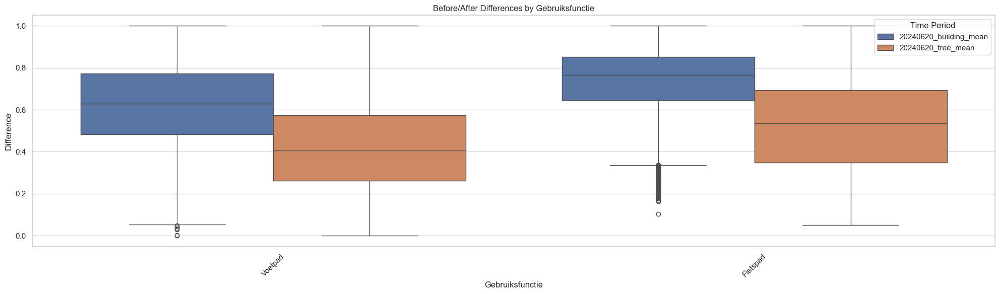

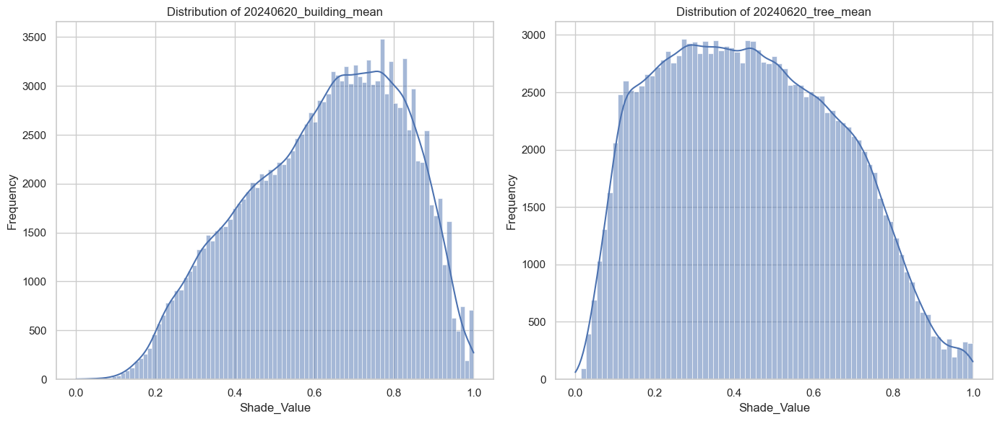

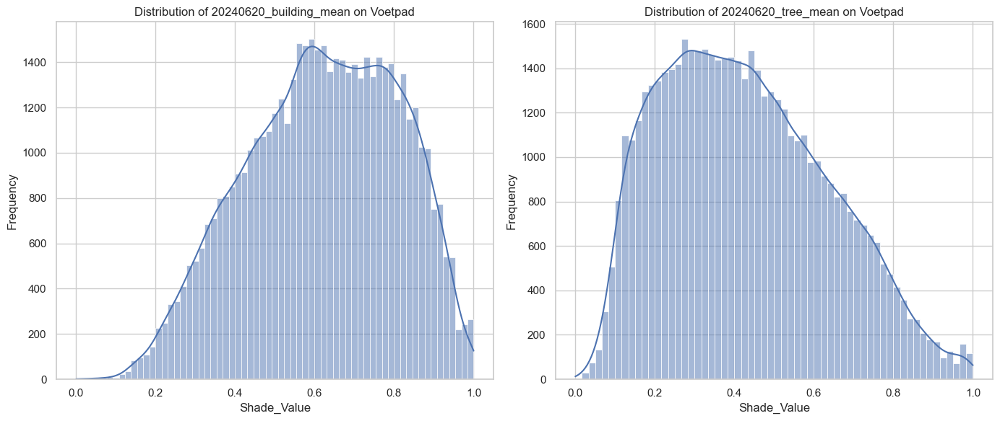

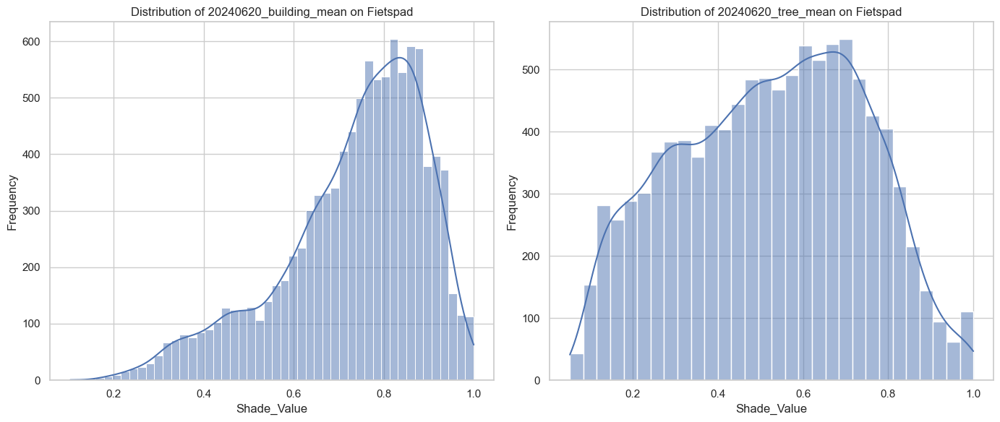

In [117]:
before_after_columns = ['20240620_building_mean', '20240620_tree_mean']

melted_gdf = filtered_gdf.melt(id_vars=['Gebruiksfunctie'], 
                      value_vars=before_after_columns, 
                      var_name='Time_Period', 
                      value_name='Shade_Value')

plt.figure(figsize=(20, 6))
sns.boxplot(x='Gebruiksfunctie', y='Shade_Value', hue='Time_Period', data=melted_gdf)
plt.title('Before/After Differences by Gebruiksfunctie')
plt.xlabel('Gebruiksfunctie')
plt.ylabel('Difference')
plt.xticks(rotation=45)
plt.legend(title='Time Period', loc='upper right')
plt.tight_layout()
plt.show()

# Histograms for before/after differences
plt.figure(figsize=(14, 6))
for i, column in enumerate(before_after_columns, 1):
    plt.subplot(1, 2, i)
    sns.histplot(gdf[column], kde=True)
    plt.title(f'Distribution of {column}')
    plt.xlabel('Shade_Value')
    plt.ylabel('Frequency')
plt.tight_layout()
plt.show()

# Define the subset of 'Gebruiksfunctie' to visualize
subset_value = ['Voetpad', 'Fietspad']

for subset in subset_value:
    gdf_subset = filtered_gdf[filtered_gdf['Gebruiksfunctie'] == subset]
    # Histograms for before/after differences
    plt.figure(figsize=(14, 6))
    for i, column in enumerate(before_after_columns, 1):
        plt.subplot(1, 2, i)
        sns.histplot(gdf_subset[column], kde=True)
        plt.title(f'Distribution of {column} on {subset}')
        plt.xlabel('Shade_Value')
        plt.ylabel('Frequency')
    plt.tight_layout()
    plt.show()



# # Scatter plot to explore relationships between columns
# plt.figure(figsize=(10, 6))
# sns.scatterplot(x=before_after_columns[0], y=before_after_columns[1], data=gdf_subset)
# plt.title('Scatter plot of Before vs After Differences')
# plt.xlabel('Before Difference')
# plt.ylabel('After Difference')
# plt.legend(title='Gebruiksfunctie')
# plt.tight_layout()
# plt.show()

# # Step 6: Spatial Analysis
# # Plotting the geospatial data
# plt.figure(figsize=(10, 10))
# gdf.plot(column=before_after_columns[0], legend=True, cmap='viridis')
# plt.title('Geospatial Plot of Before Differences')
# plt.show()

# plt.figure(figsize=(10, 10))
# gdf.plot(column=before_after_columns[0], legend=True, cmap='viridis')
# plt.title('Geospatial Plot of After Differences')
# plt.show()

In [118]:
melted_gdf.head()

,Gebruiksfunctie,Time_Period,Shade_Value
0,Voetpad,20240620_building_mean,0.911765
1,Voetpad,20240620_building_mean,0.911765
2,Voetpad,20240620_building_mean,0.757576
3,Voetpad,20240620_building_mean,0.460172
4,Voetpad,20240620_building_mean,0.933947


In [ ]:
for row, idx in dataframe.iterrows():
    trees_intersection = gpd.overlay(row, tree_dataset, how='intersection')
    

In [114]:
melted_gdf

NameError: name 'melted_gdf' is not defined